## Red Neuronal Inception V3 Tesis
# Juan David Galan Vargas - 202111470
### Correción con NUEVA MUESTRA DE ENTRENAMIENTO CON DISTANCIAS POR SHELL AJUSTADAS

In [1]:
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator, load_img
from tensorflow.keras.preprocessing import image
from tensorflow.keras.applications import InceptionV3
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D
from tensorflow.keras.optimizers import Adam
import os
import keras
from keras.models import Sequential
from keras import backend as K
from keras.layers import Input
import pandas as pd
import numpy as np
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import csv
import pydot
from tensorflow.keras.utils import plot_model
import tensorflow.keras.backend as K
from sklearn.metrics import f1_score
import matplotlib.colors as mcolors
import re

c:\Users\juang\anaconda3\lib\site-packages\pandas\core\computation\expressions.py:21: UserWarning: Pandas requires version '2.8.4' or newer of 'numexpr' (version '2.7.3' currently installed).
  from pandas.core.computation.check import NUMEXPR_INSTALLED
c:\Users\juang\anaconda3\lib\site-packages\pandas\core\arrays\masked.py:60: UserWarning: Pandas requires version '1.3.6' or newer of 'bottleneck' (version '1.3.2' currently installed).
  from pandas.core import (


In [2]:
cumulos_folder_shell1=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\Muestra Entrenamiento\Shell1\si"
nocumulos_folder_shell1=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\Muestra Entrenamiento\Shell1\no"

shell1=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\8 Semestre\Proyecto Teorico\Proyecto Teorico 20242\Gaia-DR3-Proyecto-Teorico-20242\Muestra Entrenamiento Corregida\Shell1"
shell2=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\8 Semestre\Proyecto Teorico\Proyecto Teorico 20242\Gaia-DR3-Proyecto-Teorico-20242\Muestra Entrenamiento Corregida\Shell2"

cumulos_folder_shell2=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\Muestra Entrenamiento\Shell2\si"
nocumulos_folder_shell2=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\Muestra Entrenamiento\Shell2\no"

clasificar_shell1=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\Diagramas Shell\shell1"
clasificar_shell2=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\Diagramas Shell\shell2"

### Shell 1

In [ ]:
#VALIDATION SET IMBALANCED

from sklearn.model_selection import train_test_split
from tensorflow.keras.preprocessing.image import ImageDataGenerator
train_data_dir=shell1
# Step 1: Gather image filepaths and labels
filepaths = []
labels = []

for class_name in ['no', 'si']:
    class_dir = os.path.join(train_data_dir, class_name)
    for fname in os.listdir(class_dir):
        filepaths.append(os.path.join(class_dir, fname))
        labels.append(class_name)

df = pd.DataFrame({'filename': filepaths, 'class': labels})

# Step 2: Custom class-imbalanced validation split
# Desired validation fraction and class proportions
validation_fraction = 0.15  # 15% of the full dataset
validation_no_ratio = 0.8
validation_si_ratio = 0.2

total_val_samples = int(len(df) * validation_fraction)
val_no_count = int(total_val_samples * validation_no_ratio)
val_si_count = total_val_samples - val_no_count  # to ensure the total matches

df_no = df[df['class'] == 'no']
df_si = df[df['class'] == 'si']

val_no = df_no.sample(n=val_no_count, random_state=42)
val_si = df_si.sample(n=val_si_count, random_state=42)

val_df = pd.concat([val_no, val_si])
train_df = df.drop(val_df.index)


# Step 3: Use flow_from_dataframe
train_datagen = ImageDataGenerator(
    rescale=1.0/255.0,
    rotation_range=10,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=False,
    vertical_flip=False
)

val_datagen = ImageDataGenerator(rescale=1.0/255.0)

train_generator = train_datagen.flow_from_dataframe(
    train_df,
    x_col='filename',
    y_col='class',
    target_size=(253, 385),
    class_mode='binary',
    batch_size=32,
    shuffle=True
)

validation_generator = val_datagen.flow_from_dataframe(
    val_df,
    x_col='filename',
    y_col='class',
    target_size=(253, 385),
    class_mode='binary',
    batch_size=32,
    shuffle=False  # don't shuffle validation
)


Found 8732 validated image filenames belonging to 2 classes.
Found 1540 validated image filenames belonging to 2 classes.


In [ ]:
# Data generators
train_datagen = ImageDataGenerator(
    rescale=1.0/255.0,
    rotation_range=10,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=False,
    vertical_flip=False,
    validation_split=0.15  # 20% for validation
)

# CAMBIAR SHELL 1 O SHELL 2
train_data_dir = shell1

# Training data
train_generator = train_datagen.flow_from_directory(
    train_data_dir,
    target_size=(253, 385),
    batch_size=32,
    class_mode='binary',
    classes=['no', 'si'],
    shuffle=True,
    subset='training'  # Training set (80%)
)

# Validation data
validation_generator = train_datagen.flow_from_directory(
    train_data_dir,
    target_size=(253, 385),
    batch_size=32,
    class_mode='binary',
    classes=['no', 'si'],
    shuffle=True,           # Typically don't shuffle validation data
    subset='validation'      # Validation set (20%)
)


Found 8732 images belonging to 2 classes.
Found 1540 images belonging to 2 classes.


In [5]:
def reshape_binary_labels(generator):
    for x, y in generator:
        yield x, y.reshape(-1, 1)

train_data_dir = shell1

# Data generators
train_datagen = ImageDataGenerator(
    rescale=1.0/255.0,
    rotation_range=10,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=False,
    vertical_flip=False,
    validation_split=0.15  # 20% for validation
)

train_generator = reshape_binary_labels(train_datagen.flow_from_directory(
    train_data_dir,
    target_size=(253, 385),
    batch_size=32,
    class_mode='binary',
    classes=['no', 'si'],
    shuffle=True,
    subset='training'
))

validation_generator = reshape_binary_labels(train_datagen.flow_from_directory(
    train_data_dir,
    target_size=(253, 385),
    batch_size=32,
    class_mode='binary',
    classes=['no', 'si'],
    shuffle=True,
    subset='validation'
))


Found 8732 images belonging to 2 classes.
Found 1540 images belonging to 2 classes.


In [4]:
def get_model():
    base_model = InceptionV3(input_shape = (253,385,3), weights='imagenet', include_top=False)
    x = base_model.output
    x = keras.layers.GlobalAveragePooling2D()(x)
    x = keras.layers.Dense(1024, activation='relu')(x)
    x = keras.layers.BatchNormalization()(x)
    #x = keras.layers.Dense(512, activation='relu')(x)
    #x = keras.layers.BatchNormalization()(x)
    predictions = keras.layers.Dense(1, activation='sigmoid')(x)
    model = keras.models.Model(inputs=base_model.input, outputs=predictions)
    for layer in base_model.layers:
        layer.trainable = False #Originalmente False, True en prueba
        
    for layer in base_model.layers[-150:]:
        layer.trainable = False
    return model
model = get_model()

# Compile the model


In [5]:
METRICS = [
      keras.metrics.TruePositives(name='tp'),
      keras.metrics.FalsePositives(name='fp'),
      keras.metrics.TrueNegatives(name='tn'),
      keras.metrics.FalseNegatives(name='fn'), 
      keras.metrics.BinaryAccuracy(name='accuracy'),
      keras.metrics.Precision(name='precision'),
      keras.metrics.Recall(name='recall'),
      keras.metrics.AUC(name='auc'),
]
model.compile(
    optimizer=keras.optimizers.Adam(0.001),
    loss='binary_crossentropy',
    metrics=METRICS)

In [6]:
model.fit(
    train_generator,
    validation_data=validation_generator,
    epochs=2)
    #,class_weight={0: 1.25, 1: 5.0})

c:\Users\juang\anaconda3\lib\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/2
273/273 ━━━━━━━━━━━━━━━━━━━━ 815s 3s/step - accuracy: 0.8888 - auc: 0.9456 - fn: 264.0110 - fp: 177.0146 - loss: 0.3470 - precision: 0.9163 - recall: 0.8791 - tn: 1784.3759 - tp: 2170.9490 - val_accuracy: 0.9669 - val_auc: 0.9824 - val_fn: 50.0000 - val_fp: 1.0000 - val_loss: 0.1096 - val_precision: 0.9961 - val_recall: 0.8377 - val_tn: 1231.0000 - val_tp: 258.0000
Epoch 2/2
273/273 ━━━━━━━━━━━━━━━━━━━━ 964s 4s/step - accuracy: 0.9180 - auc: 0.9684 - fn: 221.3759 - fp: 138.0329 - loss: 0.2164 - precision: 0.9407 - recall: 0.9092 - tn: 1827.3467 - tp: 2210.0767 - val_accuracy: 0.9649 - val_auc: 0.9863 - val_fn: 31.0000 - val_fp: 23.0000 - val_loss: 0.0917 - val_precision: 0.9233 - val_recall: 0.8994 - val_tn: 1209.0000 - val_tp: 277.0000


### Modelos

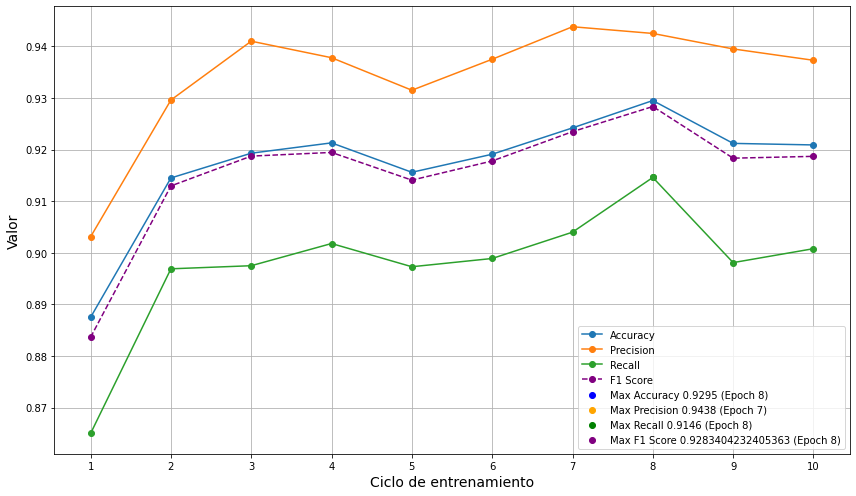

Highest Accuracy: 0.9295 at Epoch 8
Highest Precision: 0.9438 at Epoch 7
Highest Recall: 0.9146 at Epoch 8
Highest F1 Score: 0.9283404232405363 at Epoch 8


In [4]:
#MODELO 0
# Metrics data from your training output
epochs = range(1, 11)
accuracy = [0.8875, 0.9145, 0.9193, 0.9213, 0.9156, 0.9191, 0.9242, 0.9295, 0.9212, 0.9209]
precision = [0.9031, 0.9296, 0.9410, 0.9378, 0.9315, 0.9375, 0.9438, 0.9425, 0.9395, 0.9373]
recall = [0.8650, 0.8969, 0.8975, 0.9018, 0.8973, 0.8989, 0.9040, 0.9146, 0.8981, 0.9008]

# Calculate F1 score for each epoch
f1_score = [2 * (p * r) / (p + r) if (p + r) > 0 else 0 for p, r in zip(precision, recall)]

# Find the epoch with the highest F1 score
max_f1_epoch = f1_score.index(max(f1_score)) + 1

# Plot the metrics
plt.figure(figsize=(12, 7))
plt.plot(epochs, accuracy, label='Accuracy', marker='o')
plt.plot(epochs, precision, label='Precision', marker='o')
plt.plot(epochs, recall, label='Recall', marker='o')
plt.plot(epochs, f1_score, label='F1 Score', marker='o', linestyle='--', color='purple')

# Highlight the highest points
max_acc_epoch = accuracy.index(max(accuracy)) + 1
max_prec_epoch = precision.index(max(precision)) + 1
max_recall_epoch = recall.index(max(recall)) + 1

plt.scatter(max_acc_epoch, max(accuracy), color='blue', label=f"Max Accuracy {max(accuracy)} (Epoch {max_acc_epoch})")
plt.scatter(max_prec_epoch, max(precision), color='orange', label=f"Max Precision {max(precision)} (Epoch {max_prec_epoch})")
plt.scatter(max_recall_epoch, max(recall), color='green', label=f"Max Recall {max(recall)} (Epoch {max_recall_epoch})")
plt.scatter(max_f1_epoch, max(f1_score), color='purple', label=f"Max F1 Score {max(f1_score)} (Epoch {max_f1_epoch})")

# Add labels, legend, and title
#plt.title("Metrics Across Epochs for Model 0 (Only Dense Layer Trained)", fontsize=16)
plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("Valor", fontsize=14)
plt.xticks(epochs)
plt.legend()
plt.grid(True)
plt.tight_layout()

# Show the plot
plt.show()

# Print the highest values and their epochs
print(f"Highest Accuracy: {max(accuracy)} at Epoch {max_acc_epoch}")
print(f"Highest Precision: {max(precision)} at Epoch {max_prec_epoch}")
print(f"Highest Recall: {max(recall)} at Epoch {max_recall_epoch}")
print(f"Highest F1 Score: {max(f1_score)} at Epoch {max_f1_epoch}")


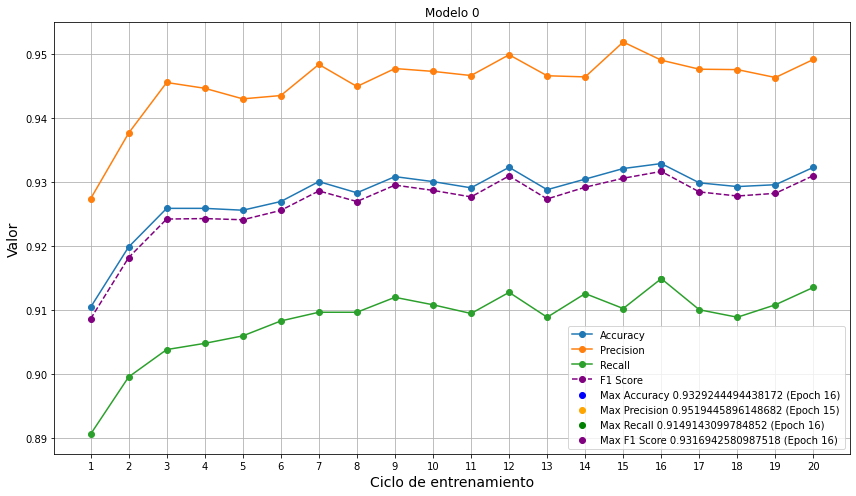

Highest Accuracy: 0.9329244494438172 at Epoch 16
Highest Precision: 0.9519445896148682 at Epoch 15
Highest Recall: 0.9149143099784852 at Epoch 16
Highest F1 Score: 0.9316942580987518 at Epoch 16


In [11]:
#MODELO 0 CLUSTER
metrica_direccion=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\metricas_modelos_cluster\metricas_modelo0.txt"
metrica=pd.read_csv(metrica_direccion)
epochs=list(metrica["Epoch"])
accuracy=list(metrica["accuracy"])
precision=list(metrica["precision"])
recall=list(metrica["recall"])
f1_score = [2 * (p * r) / (p + r) if (p + r) > 0 else 0 for p, r in zip(precision, recall)]

# Find the epoch with the highest F1 score
max_f1_epoch = f1_score.index(max(f1_score)) + 1

# Plot the metrics
plt.figure(figsize=(12, 7))
plt.plot(epochs, accuracy, label='Accuracy', marker='o')
plt.plot(epochs, precision, label='Precision', marker='o')
plt.plot(epochs, recall, label='Recall', marker='o')
plt.plot(epochs, f1_score, label='F1 Score', marker='o', linestyle='--', color='purple')

# Highlight the highest points
max_acc_epoch = accuracy.index(max(accuracy)) + 1
max_prec_epoch = precision.index(max(precision)) + 1
max_recall_epoch = recall.index(max(recall)) + 1

plt.scatter(max_acc_epoch, max(accuracy), color='blue', label=f"Max Accuracy {max(accuracy)} (Epoch {max_acc_epoch})")
plt.scatter(max_prec_epoch, max(precision), color='orange', label=f"Max Precision {max(precision)} (Epoch {max_prec_epoch})")
plt.scatter(max_recall_epoch, max(recall), color='green', label=f"Max Recall {max(recall)} (Epoch {max_recall_epoch})")
plt.scatter(max_f1_epoch, max(f1_score), color='purple', label=f"Max F1 Score {max(f1_score)} (Epoch {max_f1_epoch})")

# Add labels, legend, and title
#plt.title("Metrics Across Epochs for Model 1 (No second Dense Layer, 100 Layers)", fontsize=16)
plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("Valor", fontsize=14)
plt.title("Modelo 0")
plt.xticks(epochs)
plt.legend()
plt.grid(True)
plt.tight_layout()

# Show the plot
plt.show()

# Print the highest values and their epochs
print(f"Highest Accuracy: {max(accuracy)} at Epoch {max_acc_epoch}")
print(f"Highest Precision: {max(precision)} at Epoch {max_prec_epoch}")
print(f"Highest Recall: {max(recall)} at Epoch {max_recall_epoch}")
print(f"Highest F1 Score: {max(f1_score)} at Epoch {max_f1_epoch}")

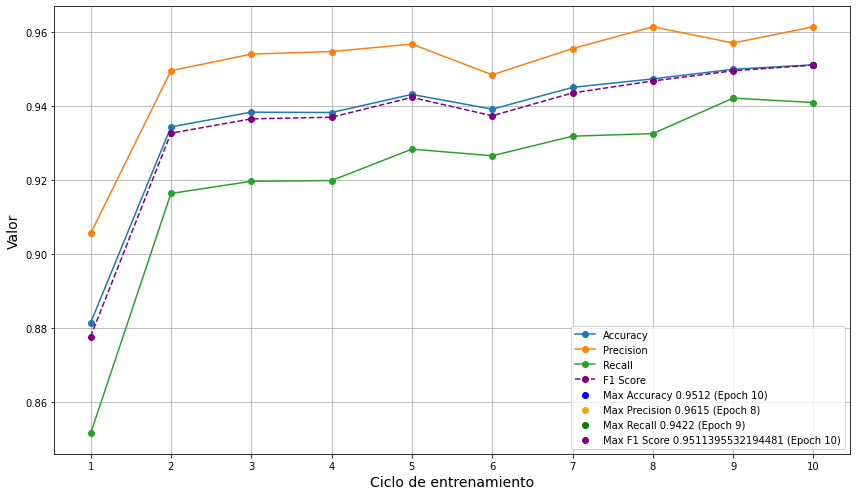

Highest Accuracy: 0.9512 at Epoch 10
Highest Precision: 0.9615 at Epoch 8
Highest Recall: 0.9422 at Epoch 9
Highest F1 Score: 0.9511395532194481 at Epoch 10


In [5]:
#MODELO 1
epochs = list(range(1, 11))  # Epochs 1 to 10

accuracy = [0.8814, 0.9344, 0.9384, 0.9383, 0.9432, 0.9392, 0.9451, 0.9474, 0.9500, 0.9512]
auc = [0.9422, 0.9790, 0.9811, 0.9802, 0.9839, 0.9827, 0.9863, 0.9876, 0.9888, 0.9906]
fn = [331.7050, 224.2547, 204.9193, 199.1087, 192.4689, 188.5745, 174.5807, 164.6429, 153.7950, 154.9783]
fp = [190.5248, 133.0217, 114.5435, 114.9565, 113.8758, 120.6553, 109.1677, 101.3789, 99.2733, 99.3758]
loss = [0.3159, 0.1737, 0.1650, 0.1669, 0.1502, 0.1598, 0.1410, 0.1343, 0.1296, 0.1204]
precision = [0.9056, 0.9496, 0.9541, 0.9548, 0.9568, 0.9485, 0.9556, 0.9615, 0.9571, 0.9615]
recall = [0.8515, 0.9164, 0.9197, 0.9199, 0.9284, 0.9266, 0.9319, 0.9326, 0.9422, 0.9410]
tn = [2372.2144, 2466.4131, 2483.5684, 2469.3262, 2466.6926, 2481.4875, 2483.9473, 2472.1987, 2482.8540, 2466.0684]
tp = [2273.4565, 2344.2112, 2364.8696, 2384.5093, 2394.8633, 2377.1833, 2400.2051, 2429.6802, 2431.9783, 2447.4783]
# Calculate the F1 score for each epoch
f1_score = [2 * (p * r) / (p + r) if (p + r) > 0 else 0 for p, r in zip(precision, recall)]

# Find the epoch with the highest F1 score
max_f1_epoch = f1_score.index(max(f1_score)) + 1

# Plot the metrics
plt.figure(figsize=(12, 7))
plt.plot(epochs, accuracy, label='Accuracy', marker='o')
plt.plot(epochs, precision, label='Precision', marker='o')
plt.plot(epochs, recall, label='Recall', marker='o')
plt.plot(epochs, f1_score, label='F1 Score', marker='o', linestyle='--', color='purple')

# Highlight the highest points
max_acc_epoch = accuracy.index(max(accuracy)) + 1
max_prec_epoch = precision.index(max(precision)) + 1
max_recall_epoch = recall.index(max(recall)) + 1

plt.scatter(max_acc_epoch, max(accuracy), color='blue', label=f"Max Accuracy {max(accuracy)} (Epoch {max_acc_epoch})")
plt.scatter(max_prec_epoch, max(precision), color='orange', label=f"Max Precision {max(precision)} (Epoch {max_prec_epoch})")
plt.scatter(max_recall_epoch, max(recall), color='green', label=f"Max Recall {max(recall)} (Epoch {max_recall_epoch})")
plt.scatter(max_f1_epoch, max(f1_score), color='purple', label=f"Max F1 Score {max(f1_score)} (Epoch {max_f1_epoch})")

# Add labels, legend, and title
#plt.title("Metrics Across Epochs for Model 1 (No second Dense Layer, 100 Layers)", fontsize=16)
plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("Valor", fontsize=14)
plt.xticks(epochs)
plt.legend()
plt.grid(True)
plt.tight_layout()

# Show the plot
plt.show()

# Print the highest values and their epochs
print(f"Highest Accuracy: {max(accuracy)} at Epoch {max_acc_epoch}")
print(f"Highest Precision: {max(precision)} at Epoch {max_prec_epoch}")
print(f"Highest Recall: {max(recall)} at Epoch {max_recall_epoch}")
print(f"Highest F1 Score: {max(f1_score)} at Epoch {max_f1_epoch}")


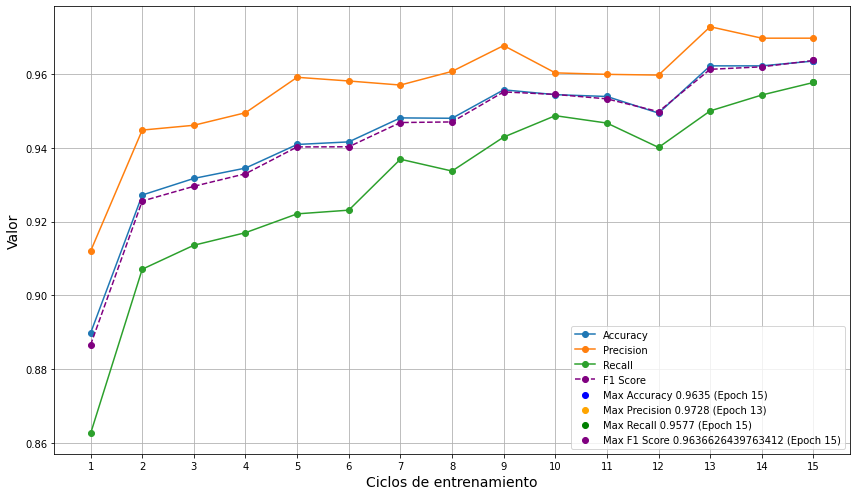

Highest Accuracy: 0.9635 at Epoch 15
Highest Precision: 0.9728 at Epoch 13
Highest Recall: 0.9577 at Epoch 15
Highest F1 Score: 0.9636626439763412 at Epoch 15


In [6]:
#Modelo 
epochs = np.arange(1, 16)
accuracy = [0.8898, 0.9272, 0.9317, 0.9345, 0.9409, 0.9416, 0.9481, 0.9480, 0.9557, 0.9544, 0.9539, 0.9494, 0.9622, 0.9622, 0.9635]
precision = [0.9120, 0.9448, 0.9461, 0.9495, 0.9591, 0.9581, 0.9570, 0.9607, 0.9677, 0.9603, 0.9599, 0.9597, 0.9728, 0.9697, 0.9697]
recall = [0.8626, 0.9071, 0.9136, 0.9170, 0.9221, 0.9231, 0.9369, 0.9337, 0.9429, 0.9487, 0.9467, 0.9401, 0.9500, 0.9543, 0.9577]

# Compute F1 score
f1_score = [2 * (p * r) / (p + r) if (p + r) > 0 else 0 for p, r in zip(precision, recall)]

# Find the epoch with the highest F1 score
max_f1_epoch = f1_score.index(max(f1_score)) + 1

# Plot the metrics
plt.figure(figsize=(12, 7))
plt.plot(epochs, accuracy, label='Accuracy', marker='o')
plt.plot(epochs, precision, label='Precision', marker='o')
plt.plot(epochs, recall, label='Recall', marker='o')
plt.plot(epochs, f1_score, label='F1 Score', marker='o', linestyle='--', color='purple')

# Highlight the highest points
max_acc_epoch = accuracy.index(max(accuracy)) + 1
max_prec_epoch = precision.index(max(precision)) + 1
max_recall_epoch = recall.index(max(recall)) + 1

plt.scatter(max_acc_epoch, max(accuracy), color='blue', label=f"Max Accuracy {max(accuracy)} (Epoch {max_acc_epoch})")
plt.scatter(max_prec_epoch, max(precision), color='orange', label=f"Max Precision {max(precision)} (Epoch {max_prec_epoch})")
plt.scatter(max_recall_epoch, max(recall), color='green', label=f"Max Recall {max(recall)} (Epoch {max_recall_epoch})")
plt.scatter(max_f1_epoch, max(f1_score), color='purple', label=f"Max F1 Score {max(f1_score)} (Epoch {max_f1_epoch})")

# Add labels, legend, and title
#plt.title("Metrics Across Epochs for Model 1 (No second Dense Layer, 100 Layers)", fontsize=16)
plt.xlabel("Ciclos de entrenamiento", fontsize=14)
plt.ylabel("Valor", fontsize=14)
plt.xticks(epochs)
plt.legend()
plt.grid(True)
plt.tight_layout()

# Show the plot
plt.show()

# Print the highest values and their epochs
print(f"Highest Accuracy: {max(accuracy)} at Epoch {max_acc_epoch}")
print(f"Highest Precision: {max(precision)} at Epoch {max_prec_epoch}")
print(f"Highest Recall: {max(recall)} at Epoch {max_recall_epoch}")
print(f"Highest F1 Score: {max(f1_score)} at Epoch {max_f1_epoch}")


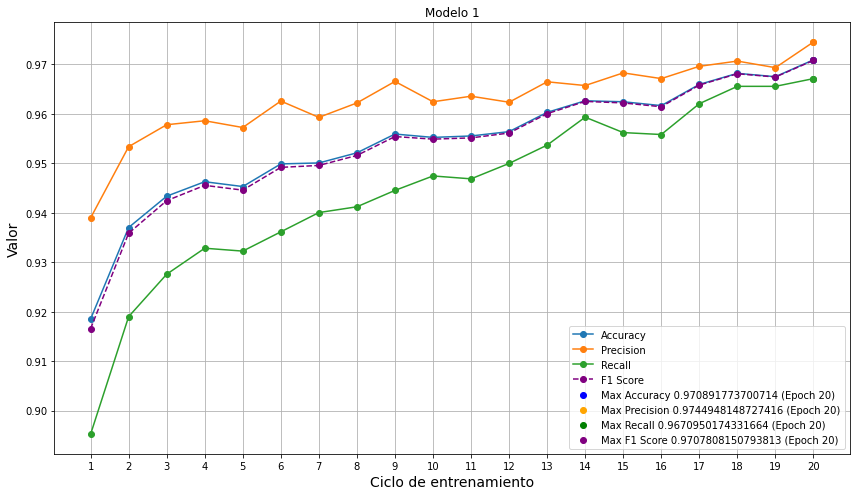

Highest Accuracy: 0.970891773700714 at Epoch 20
Highest Precision: 0.9744948148727416 at Epoch 20
Highest Recall: 0.9670950174331664 at Epoch 20
Highest F1 Score: 0.9707808150793813 at Epoch 20


In [12]:
#MODELO 1 CLUSTER
metrica_direccion=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\metricas_modelos_cluster\metricas_modelo1.txt"
metrica=pd.read_csv(metrica_direccion)
epochs=list(metrica["Epoch"])
accuracy=list(metrica["accuracy"])
precision=list(metrica["precision"])
recall=list(metrica["recall"])
f1_score = [2 * (p * r) / (p + r) if (p + r) > 0 else 0 for p, r in zip(precision, recall)]

# Find the epoch with the highest F1 score
max_f1_epoch = f1_score.index(max(f1_score)) + 1

# Plot the metrics
plt.figure(figsize=(12, 7))
plt.plot(epochs, accuracy, label='Accuracy', marker='o')
plt.plot(epochs, precision, label='Precision', marker='o')
plt.plot(epochs, recall, label='Recall', marker='o')
plt.plot(epochs, f1_score, label='F1 Score', marker='o', linestyle='--', color='purple')

# Highlight the highest points
max_acc_epoch = accuracy.index(max(accuracy)) + 1
max_prec_epoch = precision.index(max(precision)) + 1
max_recall_epoch = recall.index(max(recall)) + 1

plt.scatter(max_acc_epoch, max(accuracy), color='blue', label=f"Max Accuracy {max(accuracy)} (Epoch {max_acc_epoch})")
plt.scatter(max_prec_epoch, max(precision), color='orange', label=f"Max Precision {max(precision)} (Epoch {max_prec_epoch})")
plt.scatter(max_recall_epoch, max(recall), color='green', label=f"Max Recall {max(recall)} (Epoch {max_recall_epoch})")
plt.scatter(max_f1_epoch, max(f1_score), color='purple', label=f"Max F1 Score {max(f1_score)} (Epoch {max_f1_epoch})")

# Add labels, legend, and title
#plt.title("Metrics Across Epochs for Model 1 (No second Dense Layer, 100 Layers)", fontsize=16)
plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("Valor", fontsize=14)
plt.title("Modelo 1")
plt.xticks(epochs)
plt.legend()
plt.grid(True)
plt.tight_layout()

# Show the plot
plt.show()

# Print the highest values and their epochs
print(f"Highest Accuracy: {max(accuracy)} at Epoch {max_acc_epoch}")
print(f"Highest Precision: {max(precision)} at Epoch {max_prec_epoch}")
print(f"Highest Recall: {max(recall)} at Epoch {max_recall_epoch}")
print(f"Highest F1 Score: {max(f1_score)} at Epoch {max_f1_epoch}")

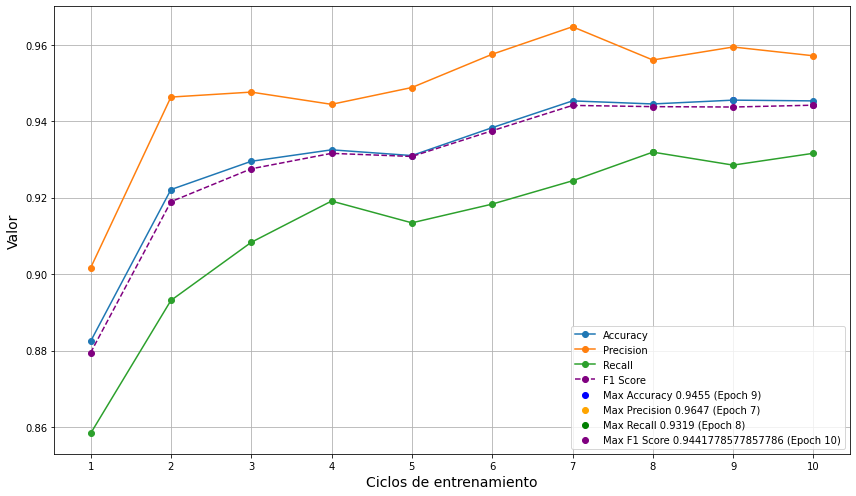

Highest Accuracy: 0.9455 at Epoch 9
Highest Precision: 0.9647 at Epoch 7
Highest Recall: 0.9319 at Epoch 8
Highest F1 Score: 0.9441778577857786 at Epoch 10


In [7]:
#MODELO 2
epochs = list(range(1, 11))  # Epochs 1 to 10

accuracy = [0.8824, 0.9221, 0.9295, 0.9325, 0.9310, 0.9383, 0.9453, 0.9445, 0.9455, 0.9453]
auc = [0.9418, 0.9721, 0.9779, 0.9805, 0.9797, 0.9833, 0.9847, 0.9868, 0.9860, 0.9870]
fn = [329.8696, 259.6397, 233.6801, 218.7609, 224.2795, 209.5435, 187.2888, 175.9845, 177.4006, 172.9317]
fp = [198.6211, 128.2764, 130.4845, 138.8634, 126.2360, 103.7453, 90.2857, 109.3385, 101.1087, 104.3571]
loss = [0.3316, 0.1991, 0.1777, 0.1718, 0.1741, 0.1563, 0.1445, 0.1373, 0.1437, 0.1390]
precision = [0.9016, 0.9463, 0.9476, 0.9444, 0.9488, 0.9575, 0.9647, 0.9560, 0.9594, 0.9571]
recall = [0.8583, 0.8931, 0.9083, 0.9191, 0.9134, 0.9183, 0.9244, 0.9319, 0.9285, 0.9316]
tn = [2397.5715, 2467.4067, 2456.2051, 2440.9006, 2429.2515, 2464.8508, 2493.6335, 2477.1086, 2509.8665, 2484.4380]
tp = [2241.8386, 2312.5776, 2347.5310, 2369.3757, 2388.1335, 2389.7610, 2396.6926, 2405.4690, 2379.5249, 2406.1738]
# Calculate the F1 score for each epoch
f1_score = [2 * (p * r) / (p + r) if (p + r) > 0 else 0 for p, r in zip(precision, recall)]

# Find the epoch with the highest F1 score
max_f1_epoch = f1_score.index(max(f1_score)) + 1

# Plot the metrics
plt.figure(figsize=(12, 7))
plt.plot(epochs, accuracy, label='Accuracy', marker='o')
plt.plot(epochs, precision, label='Precision', marker='o')
plt.plot(epochs, recall, label='Recall', marker='o')
plt.plot(epochs, f1_score, label='F1 Score', marker='o', linestyle='--', color='purple')

# Highlight the highest points
max_acc_epoch = accuracy.index(max(accuracy)) + 1
max_prec_epoch = precision.index(max(precision)) + 1
max_recall_epoch = recall.index(max(recall)) + 1

plt.scatter(max_acc_epoch, max(accuracy), color='blue', label=f"Max Accuracy {max(accuracy)} (Epoch {max_acc_epoch})")
plt.scatter(max_prec_epoch, max(precision), color='orange', label=f"Max Precision {max(precision)} (Epoch {max_prec_epoch})")
plt.scatter(max_recall_epoch, max(recall), color='green', label=f"Max Recall {max(recall)} (Epoch {max_recall_epoch})")
plt.scatter(max_f1_epoch, max(f1_score), color='purple', label=f"Max F1 Score {max(f1_score)} (Epoch {max_f1_epoch})")

# Add labels, legend, and title
#plt.title("Metrics Across Epochs for Model 2 (2nd Dense Layer)", fontsize=16)
plt.xlabel("Ciclos de entrenamiento", fontsize=14)
plt.ylabel("Valor", fontsize=14)
plt.xticks(epochs)
plt.legend()
plt.grid(True)
plt.tight_layout()

# Show the plot
plt.show()

# Print the highest values and their epochs
print(f"Highest Accuracy: {max(accuracy)} at Epoch {max_acc_epoch}")
print(f"Highest Precision: {max(precision)} at Epoch {max_prec_epoch}")
print(f"Highest Recall: {max(recall)} at Epoch {max_recall_epoch}")
print(f"Highest F1 Score: {max(f1_score)} at Epoch {max_f1_epoch}")



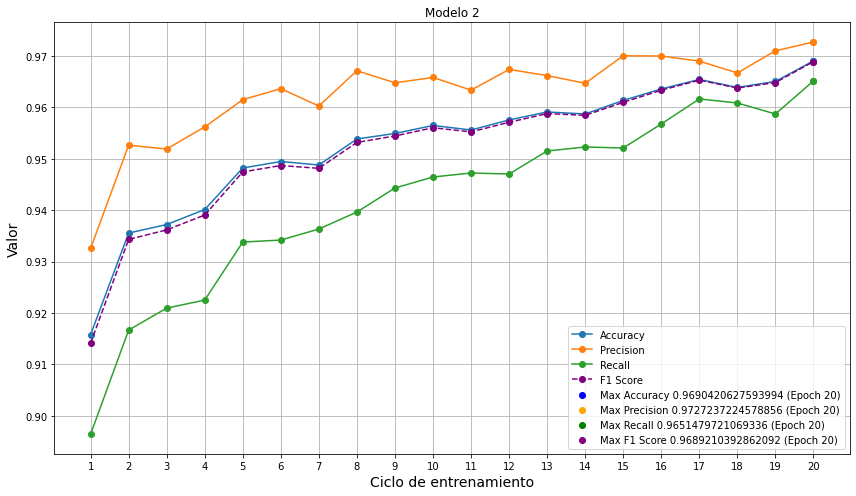

Highest Accuracy: 0.9690420627593994 at Epoch 20
Highest Precision: 0.9727237224578856 at Epoch 20
Highest Recall: 0.9651479721069336 at Epoch 20
Highest F1 Score: 0.9689210392862092 at Epoch 20


In [17]:
#MODELO 2 CLUSTER
metrica_direccion=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\metricas_modelos_cluster\metricas_modelo2.txt"
metrica=pd.read_csv(metrica_direccion)
epochs=list(metrica["Epoch"])
accuracy=list(metrica["accuracy"])
precision=list(metrica["precision"])
recall=list(metrica["recall"])
f1_score = [2 * (p * r) / (p + r) if (p + r) > 0 else 0 for p, r in zip(precision, recall)]

# Find the epoch with the highest F1 score
max_f1_epoch = f1_score.index(max(f1_score)) + 1

# Plot the metrics
plt.figure(figsize=(12, 7))
plt.plot(epochs, accuracy, label='Accuracy', marker='o')
plt.plot(epochs, precision, label='Precision', marker='o')
plt.plot(epochs, recall, label='Recall', marker='o')
plt.plot(epochs, f1_score, label='F1 Score', marker='o', linestyle='--', color='purple')

# Highlight the highest points
max_acc_epoch = accuracy.index(max(accuracy)) + 1
max_prec_epoch = precision.index(max(precision)) + 1
max_recall_epoch = recall.index(max(recall)) + 1

plt.scatter(max_acc_epoch, max(accuracy), color='blue', label=f"Max Accuracy {max(accuracy)} (Epoch {max_acc_epoch})")
plt.scatter(max_prec_epoch, max(precision), color='orange', label=f"Max Precision {max(precision)} (Epoch {max_prec_epoch})")
plt.scatter(max_recall_epoch, max(recall), color='green', label=f"Max Recall {max(recall)} (Epoch {max_recall_epoch})")
plt.scatter(max_f1_epoch, max(f1_score), color='purple', label=f"Max F1 Score {max(f1_score)} (Epoch {max_f1_epoch})")

# Add labels, legend, and title
#plt.title("Metrics Across Epochs for Model 1 (No second Dense Layer, 100 Layers)", fontsize=16)
plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("Valor", fontsize=14)
plt.title("Modelo 2")
plt.xticks(epochs)
plt.legend()
plt.grid(True)
plt.tight_layout()

# Show the plot
plt.show()

# Print the highest values and their epochs
print(f"Highest Accuracy: {max(accuracy)} at Epoch {max_acc_epoch}")
print(f"Highest Precision: {max(precision)} at Epoch {max_prec_epoch}")
print(f"Highest Recall: {max(recall)} at Epoch {max_recall_epoch}")
print(f"Highest F1 Score: {max(f1_score)} at Epoch {max_f1_epoch}")

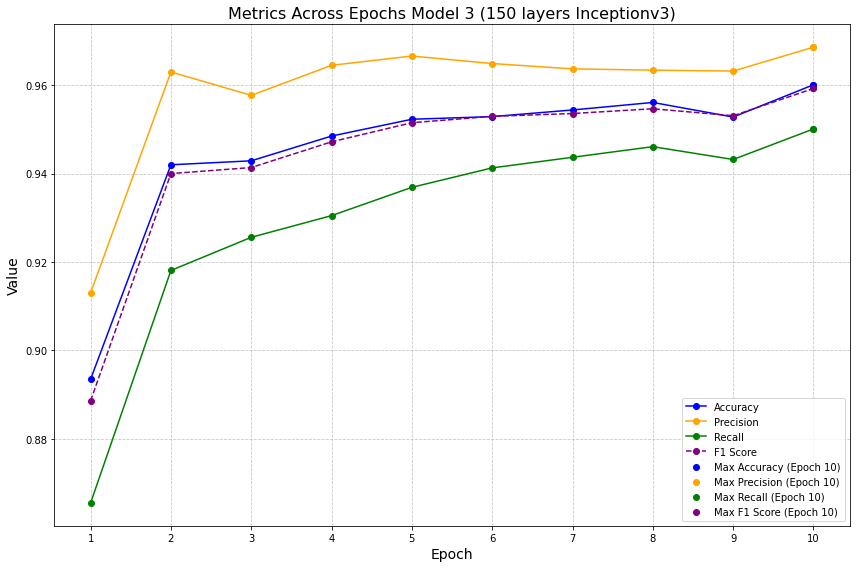

Highest Accuracy: 0.9601 at Epoch 10
Highest Precision: 0.9686 at Epoch 10
Highest Recall: 0.9501 at Epoch 10
Highest F1 Score: 0.9593 at Epoch 10


In [ ]:
#MODELO 3
epochs = range(1, 11)
accuracy = [0.8935, 0.9420, 0.9429, 0.9485, 0.9523, 0.9529, 0.9544, 0.9561, 0.9528, 0.9601]
precision = [0.9130, 0.9630, 0.9577, 0.9645, 0.9666, 0.9649, 0.9637, 0.9634, 0.9632, 0.9686]
recall = [0.8655, 0.9181, 0.9256, 0.9305, 0.9369, 0.9413, 0.9437, 0.9461, 0.9432, 0.9501]

# Calculate F1 score for each epoch
f1_score = [2 * (p * r) / (p + r) if (p + r) > 0 else 0 for p, r in zip(precision, recall)]

# Find the epochs with the highest values for each metric
max_acc_epoch = accuracy.index(max(accuracy)) + 1
max_prec_epoch = precision.index(max(precision)) + 1
max_recall_epoch = recall.index(max(recall)) + 1
max_f1_epoch = f1_score.index(max(f1_score)) + 1

# Plot the metrics
plt.figure(figsize=(12, 8))
plt.plot(epochs, accuracy, label="Accuracy", marker='o', color='blue')
plt.plot(epochs, precision, label="Precision", marker='o', color='orange')
plt.plot(epochs, recall, label="Recall", marker='o', color='green')
plt.plot(epochs, f1_score, label="F1 Score", marker='o', linestyle='--', color='purple')

# Highlight the highest points
plt.scatter(max_acc_epoch, max(accuracy), color='blue', label=f"Max Accuracy {max(accuracy)} (Epoch {max_acc_epoch})")
plt.scatter(max_prec_epoch, max(precision), color='orange', label=f"Max Precision {max(precision)} (Epoch {max_prec_epoch})")
plt.scatter(max_recall_epoch, max(recall), color='green', label=f"Max Recall {max(recall)} (Epoch {max_recall_epoch})")
plt.scatter(max_f1_epoch, max(f1_score), color='purple', label=f"Max F1 Score {max(f1_score)} (Epoch {max_f1_epoch})")

# Add labels, legend, and grid
plt.title("Metrics Across Epochs Model 3 (150 layers Inceptionv3)", fontsize=16)
plt.xlabel("Epoch", fontsize=14)
plt.ylabel("Value", fontsize=14)
plt.xticks(epochs)
plt.legend()
plt.grid(True, linestyle='--', alpha=0.7)
plt.tight_layout()

# Show the plot
plt.show()

# Print the epochs with the highest values
print(f"Highest Accuracy: {max(accuracy):.4f} at Epoch {max_acc_epoch}")
print(f"Highest Precision: {max(precision):.4f} at Epoch {max_prec_epoch}")
print(f"Highest Recall: {max(recall):.4f} at Epoch {max_recall_epoch}")
print(f"Highest F1 Score: {max(f1_score):.4f} at Epoch {max_f1_epoch}")


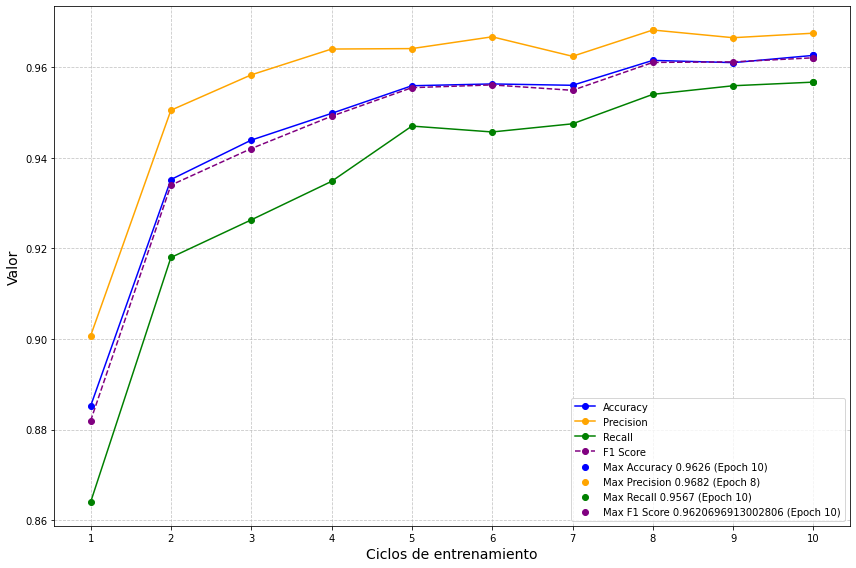

Highest Accuracy: 0.9626 at Epoch 10
Highest Precision: 0.9682 at Epoch 8
Highest Recall: 0.9567 at Epoch 10
Highest F1 Score: 0.9621 at Epoch 10


In [8]:
#MODELO 3 MUESTRA DE ENTRENAMIENTO CORREGIDO
epochs = list(range(1, 11))  # Epochs 1 to 10

accuracy = [0.8852, 0.9352, 0.9439, 0.9498, 0.9559, 0.9563, 0.9560, 0.9615, 0.9610, 0.9626]
auc = [0.9471, 0.9785, 0.9834, 0.9867, 0.9904, 0.9915, 0.9920, 0.9932, 0.9944, 0.9946]
fn = [295.9969, 207.6584, 182.9503, 167.9099, 144.1087, 145.8975, 130.2205, 116.7205, 114.1025, 110.5870]
fp = [201.0186, 124.4969, 97.6056, 96.5217, 94.0093, 86.2888, 91.6180, 81.6087, 79.8323, 82.8230]
loss = [0.3066, 0.1749, 0.1529, 0.1348, 0.1171, 0.1117, 0.1069, 0.0990, 0.0926, 0.0888]
precision = [0.9007, 0.9505, 0.9583, 0.9640, 0.9641, 0.9667, 0.9624, 0.9682, 0.9665, 0.9675]
recall = [0.8640, 0.9180, 0.9263, 0.9348, 0.9470, 0.9457, 0.9475, 0.9540, 0.9559, 0.9567]
tn = [2405.1895, 2449.5374, 2501.1646, 2481.3416, 2500.0249, 2484.9534, 2506.8167, 2498.6492, 2498.6709, 2524.5466]
tp = [2265.6956, 2386.2080, 2386.1802, 2422.1274, 2429.7578, 2450.7610, 2439.2454, 2470.9224, 2475.2949, 2449.9441]


# Calculate F1 score for each epoch
f1_score = [2 * (p * r) / (p + r) if (p + r) > 0 else 0 for p, r in zip(precision, recall)]

# Find the epochs with the highest values for each metric
max_acc_epoch = accuracy.index(max(accuracy)) + 1
max_prec_epoch = precision.index(max(precision)) + 1
max_recall_epoch = recall.index(max(recall)) + 1
max_f1_epoch = f1_score.index(max(f1_score)) + 1

# Plot the metrics
plt.figure(figsize=(12, 8))
plt.plot(epochs, accuracy, label="Accuracy", marker='o', color='blue')
plt.plot(epochs, precision, label="Precision", marker='o', color='orange')
plt.plot(epochs, recall, label="Recall", marker='o', color='green')
plt.plot(epochs, f1_score, label="F1 Score", marker='o', linestyle='--', color='purple')

# Highlight the highest points
plt.scatter(max_acc_epoch, max(accuracy), color='blue', label=f"Max Accuracy {max(accuracy)} (Epoch {max_acc_epoch})")
plt.scatter(max_prec_epoch, max(precision), color='orange', label=f"Max Precision {max(precision)} (Epoch {max_prec_epoch})")
plt.scatter(max_recall_epoch, max(recall), color='green', label=f"Max Recall {max(recall)} (Epoch {max_recall_epoch})")
plt.scatter(max_f1_epoch, max(f1_score), color='purple', label=f"Max F1 Score {max(f1_score)} (Epoch {max_f1_epoch})")

# Add labels, legend, and grid
#plt.title("Metrics Across Epochs Model 3 (150 layers Inceptionv3) (NEW TRAINING SET)", fontsize=16)
plt.xlabel("Ciclos de entrenamiento", fontsize=14)
plt.ylabel("Valor", fontsize=14)
plt.xticks(epochs)
plt.legend()
plt.grid(True, linestyle='--', alpha=0.7)
plt.tight_layout()

# Show the plot
plt.show()

# Print the epochs with the highest values
print(f"Highest Accuracy: {max(accuracy):.4f} at Epoch {max_acc_epoch}")
print(f"Highest Precision: {max(precision):.4f} at Epoch {max_prec_epoch}")
print(f"Highest Recall: {max(recall):.4f} at Epoch {max_recall_epoch}")
print(f"Highest F1 Score: {max(f1_score):.4f} at Epoch {max_f1_epoch}")


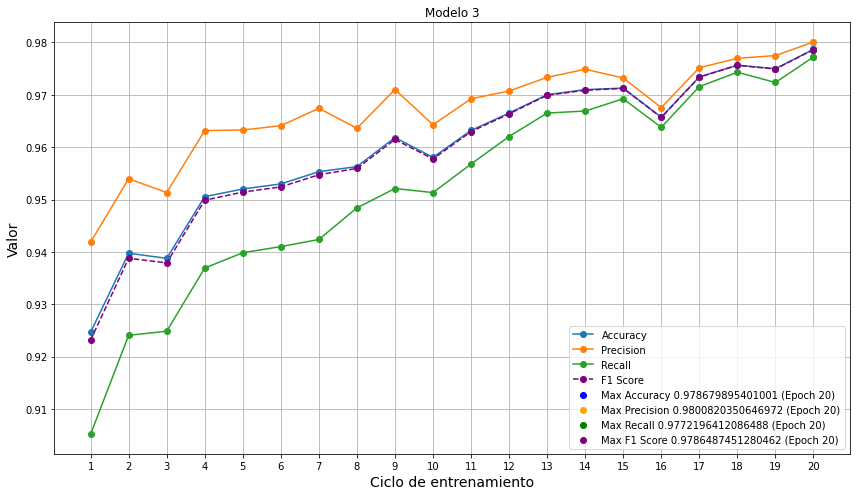

Highest Accuracy: 0.978679895401001 at Epoch 20
Highest Precision: 0.9800820350646972 at Epoch 20
Highest Recall: 0.9772196412086488 at Epoch 20
Highest F1 Score: 0.9786487451280462 at Epoch 20


In [3]:
#MODELO 3 CLUSTER
metrica_direccion=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\metricas_modelos_cluster\metricas_modelo3.txt"
metrica=pd.read_csv(metrica_direccion)
epochs=list(metrica["Epoch"])
accuracy=list(metrica["accuracy"])
precision=list(metrica["precision"])
recall=list(metrica["recall"])
f1_score = [2 * (p * r) / (p + r) if (p + r) > 0 else 0 for p, r in zip(precision, recall)]

# Find the epoch with the highest F1 score
max_f1_epoch = f1_score.index(max(f1_score)) + 1

# Plot the metrics
plt.figure(figsize=(12, 7))
plt.plot(epochs, accuracy, label='Accuracy', marker='o')
plt.plot(epochs, precision, label='Precision', marker='o')
plt.plot(epochs, recall, label='Recall', marker='o')
plt.plot(epochs, f1_score, label='F1 Score', marker='o', linestyle='--', color='purple')

# Highlight the highest points
max_acc_epoch = accuracy.index(max(accuracy)) + 1
max_prec_epoch = precision.index(max(precision)) + 1
max_recall_epoch = recall.index(max(recall)) + 1

plt.scatter(max_acc_epoch, max(accuracy), color='blue', label=f"Max Accuracy {max(accuracy)} (Epoch {max_acc_epoch})")
plt.scatter(max_prec_epoch, max(precision), color='orange', label=f"Max Precision {max(precision)} (Epoch {max_prec_epoch})")
plt.scatter(max_recall_epoch, max(recall), color='green', label=f"Max Recall {max(recall)} (Epoch {max_recall_epoch})")
plt.scatter(max_f1_epoch, max(f1_score), color='purple', label=f"Max F1 Score {max(f1_score)} (Epoch {max_f1_epoch})")

# Add labels, legend, and title
#plt.title("Metrics Across Epochs for Model 1 (No second Dense Layer, 100 Layers)", fontsize=16)
plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("Valor", fontsize=14)
plt.title("Modelo 3")
plt.xticks(epochs)
plt.legend()
plt.grid(True)
plt.tight_layout()

# Show the plot
plt.show()

# Print the highest values and their epochs
print(f"Highest Accuracy: {max(accuracy)} at Epoch {max_acc_epoch}")
print(f"Highest Precision: {max(precision)} at Epoch {max_prec_epoch}")
print(f"Highest Recall: {max(recall)} at Epoch {max_recall_epoch}")
print(f"Highest F1 Score: {max(f1_score)} at Epoch {max_f1_epoch}")

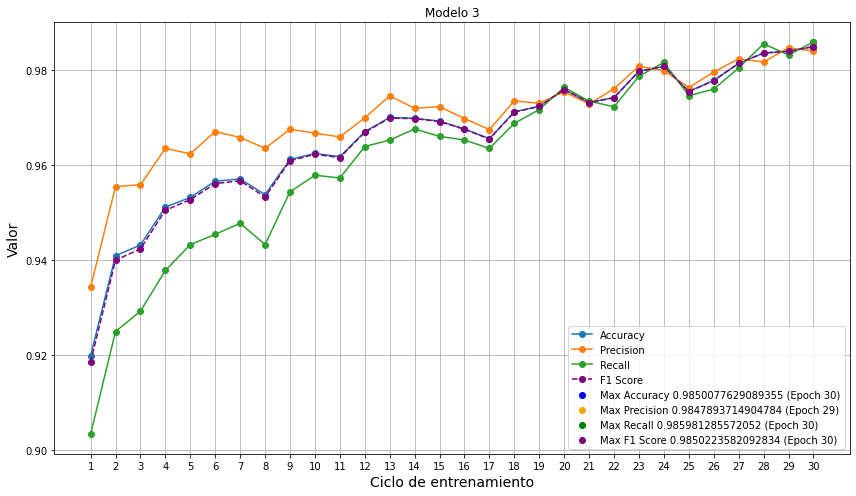

Highest Accuracy: 0.9850077629089355 at Epoch 30
Highest Precision: 0.9847893714904784 at Epoch 29
Highest Recall: 0.985981285572052 at Epoch 30
Highest F1 Score: 0.9850223582092834 at Epoch 30


In [3]:
#MODELO 3 CLUSTER
metrica_direccion=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\metricas_modelos_cluster\metricas_modelo3_30ciclos.txt"
metrica=pd.read_csv(metrica_direccion)
epochs=list(metrica["Epoch"])
accuracy=list(metrica["accuracy"])
precision=list(metrica["precision"])
recall=list(metrica["recall"])
f1_score = [2 * (p * r) / (p + r) if (p + r) > 0 else 0 for p, r in zip(precision, recall)]

# Find the epoch with the highest F1 score
max_f1_epoch = f1_score.index(max(f1_score)) + 1

# Plot the metrics
plt.figure(figsize=(12, 7))
plt.plot(epochs, accuracy, label='Accuracy', marker='o')
plt.plot(epochs, precision, label='Precision', marker='o')
plt.plot(epochs, recall, label='Recall', marker='o')
plt.plot(epochs, f1_score, label='F1 Score', marker='o', linestyle='--', color='purple')

# Highlight the highest points
max_acc_epoch = accuracy.index(max(accuracy)) + 1
max_prec_epoch = precision.index(max(precision)) + 1
max_recall_epoch = recall.index(max(recall)) + 1

plt.scatter(max_acc_epoch, max(accuracy), color='blue', label=f"Max Accuracy {max(accuracy)} (Epoch {max_acc_epoch})")
plt.scatter(max_prec_epoch, max(precision), color='orange', label=f"Max Precision {max(precision)} (Epoch {max_prec_epoch})")
plt.scatter(max_recall_epoch, max(recall), color='green', label=f"Max Recall {max(recall)} (Epoch {max_recall_epoch})")
plt.scatter(max_f1_epoch, max(f1_score), color='purple', label=f"Max F1 Score {max(f1_score)} (Epoch {max_f1_epoch})")

# Add labels, legend, and title
#plt.title("Metrics Across Epochs for Model 1 (No second Dense Layer, 100 Layers)", fontsize=16)
plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("Valor", fontsize=14)
plt.title("Modelo 3")
plt.xticks(epochs)
plt.legend()
plt.grid(True)
plt.tight_layout()

# Show the plot
plt.show()

# Print the highest values and their epochs
print(f"Highest Accuracy: {max(accuracy)} at Epoch {max_acc_epoch}")
print(f"Highest Precision: {max(precision)} at Epoch {max_prec_epoch}")
print(f"Highest Recall: {max(recall)} at Epoch {max_recall_epoch}")
print(f"Highest F1 Score: {max(f1_score)} at Epoch {max_f1_epoch}")

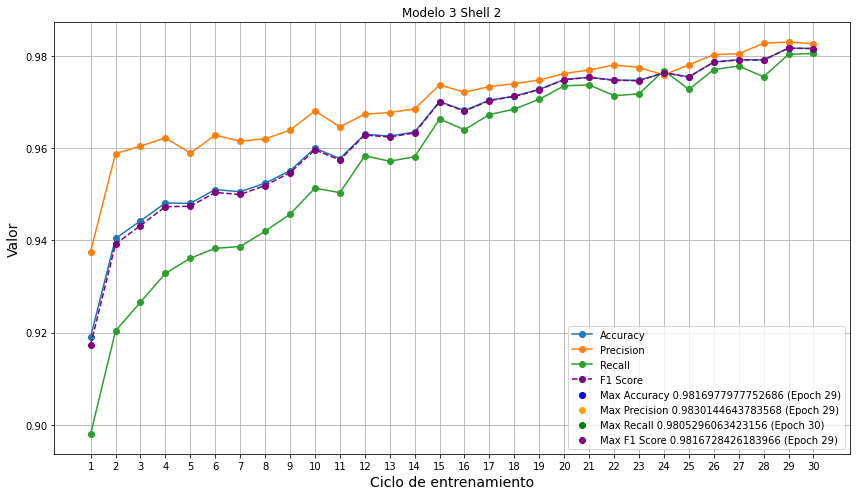

Highest Accuracy: 0.9816977977752686 at Epoch 29
Highest Precision: 0.9830144643783568 at Epoch 29
Highest Recall: 0.9805296063423156 at Epoch 30
Highest F1 Score: 0.9816728426183966 at Epoch 29


In [3]:
#MODELO 3 CLUSTER SHELL 2
metrica_direccion=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\metricas_modelos_cluster\metricas_modelo3_30ciclos_shell2.txt"
metrica=pd.read_csv(metrica_direccion)
epochs=list(metrica["Epoch"])
accuracy=list(metrica["accuracy"])
precision=list(metrica["precision"])
recall=list(metrica["recall"])
f1_score = [2 * (p * r) / (p + r) if (p + r) > 0 else 0 for p, r in zip(precision, recall)]

# Find the epoch with the highest F1 score
max_f1_epoch = f1_score.index(max(f1_score)) + 1

# Plot the metrics
plt.figure(figsize=(12, 7))
plt.plot(epochs, accuracy, label='Accuracy', marker='o')
plt.plot(epochs, precision, label='Precision', marker='o')
plt.plot(epochs, recall, label='Recall', marker='o')
plt.plot(epochs, f1_score, label='F1 Score', marker='o', linestyle='--', color='purple')

# Highlight the highest points
max_acc_epoch = accuracy.index(max(accuracy)) + 1
max_prec_epoch = precision.index(max(precision)) + 1
max_recall_epoch = recall.index(max(recall)) + 1

plt.scatter(max_acc_epoch, max(accuracy), color='blue', label=f"Max Accuracy {max(accuracy)} (Epoch {max_acc_epoch})")
plt.scatter(max_prec_epoch, max(precision), color='orange', label=f"Max Precision {max(precision)} (Epoch {max_prec_epoch})")
plt.scatter(max_recall_epoch, max(recall), color='green', label=f"Max Recall {max(recall)} (Epoch {max_recall_epoch})")
plt.scatter(max_f1_epoch, max(f1_score), color='purple', label=f"Max F1 Score {max(f1_score)} (Epoch {max_f1_epoch})")

# Add labels, legend, and title
#plt.title("Metrics Across Epochs for Model 1 (No second Dense Layer, 100 Layers)", fontsize=16)
plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("Valor", fontsize=14)
plt.title("Modelo 3 Shell 2")
plt.xticks(epochs)
plt.legend()
plt.grid(True)
plt.tight_layout()

# Show the plot
plt.show()

# Print the highest values and their epochs
print(f"Highest Accuracy: {max(accuracy)} at Epoch {max_acc_epoch}")
print(f"Highest Precision: {max(precision)} at Epoch {max_prec_epoch}")
print(f"Highest Recall: {max(recall)} at Epoch {max_recall_epoch}")
print(f"Highest F1 Score: {max(f1_score)} at Epoch {max_f1_epoch}")

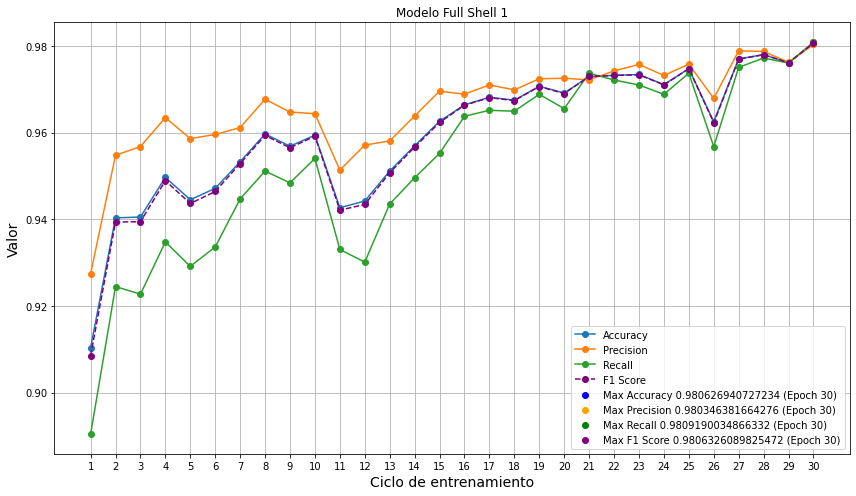

Highest Accuracy: 0.980626940727234 at Epoch 30
Highest Precision: 0.980346381664276 at Epoch 30
Highest Recall: 0.9809190034866332 at Epoch 30
Highest F1 Score: 0.9806326089825472 at Epoch 30


In [3]:
#MODELO FULL CLUSTER SHELL 1
metrica_direccion=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\metricas_modelos_cluster\metricas_modeloFull.txt"
metrica=pd.read_csv(metrica_direccion)
epochs=list(metrica["Epoch"])
accuracy=list(metrica["accuracy"])
precision=list(metrica["precision"])
recall=list(metrica["recall"])
f1_score = [2 * (p * r) / (p + r) if (p + r) > 0 else 0 for p, r in zip(precision, recall)]

# Find the epoch with the highest F1 score
max_f1_epoch = f1_score.index(max(f1_score)) + 1

# Plot the metrics
plt.figure(figsize=(12, 7))
plt.plot(epochs, accuracy, label='Accuracy', marker='o')
plt.plot(epochs, precision, label='Precision', marker='o')
plt.plot(epochs, recall, label='Recall', marker='o')
plt.plot(epochs, f1_score, label='F1 Score', marker='o', linestyle='--', color='purple')

# Highlight the highest points
max_acc_epoch = accuracy.index(max(accuracy)) + 1
max_prec_epoch = precision.index(max(precision)) + 1
max_recall_epoch = recall.index(max(recall)) + 1

plt.scatter(max_acc_epoch, max(accuracy), color='blue', label=f"Max Accuracy {max(accuracy)} (Epoch {max_acc_epoch})")
plt.scatter(max_prec_epoch, max(precision), color='orange', label=f"Max Precision {max(precision)} (Epoch {max_prec_epoch})")
plt.scatter(max_recall_epoch, max(recall), color='green', label=f"Max Recall {max(recall)} (Epoch {max_recall_epoch})")
plt.scatter(max_f1_epoch, max(f1_score), color='purple', label=f"Max F1 Score {max(f1_score)} (Epoch {max_f1_epoch})")

# Add labels, legend, and title
#plt.title("Metrics Across Epochs for Model 1 (No second Dense Layer, 100 Layers)", fontsize=16)
plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("Valor", fontsize=14)
plt.title("Modelo Full Shell 1")
plt.xticks(epochs)
plt.legend()
plt.grid(True)
plt.tight_layout()

# Show the plot
plt.show()

# Print the highest values and their epochs
print(f"Highest Accuracy: {max(accuracy)} at Epoch {max_acc_epoch}")
print(f"Highest Precision: {max(precision)} at Epoch {max_prec_epoch}")
print(f"Highest Recall: {max(recall)} at Epoch {max_recall_epoch}")
print(f"Highest F1 Score: {max(f1_score)} at Epoch {max_f1_epoch}")

### Modelos Convergentes (Diferencia)

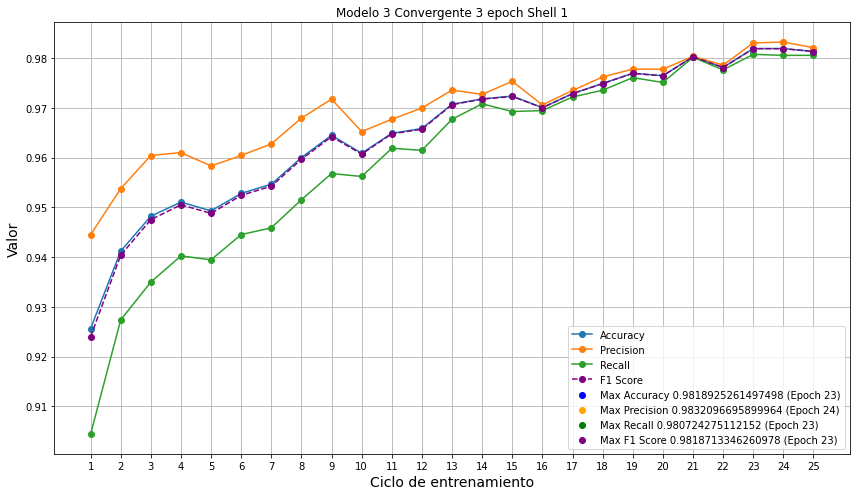

Highest Accuracy: 0.9818925261497498 at Epoch 23
Highest Precision: 0.9832096695899964 at Epoch 24
Highest Recall: 0.980724275112152 at Epoch 23
Highest F1 Score: 0.9818713346260978 at Epoch 23


In [ ]:
#MODELO 3 CONVERGENTE 3 0.001 EPOCHS CLUSTER SHELL 1
metrica_direccion=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\metricas_modelos_cluster\metricas_modelo_convergente150.txt"
metrica=pd.read_csv(metrica_direccion)
epochs=list(metrica["Epoch"])
accuracy=list(metrica["accuracy"])
precision=list(metrica["precision"])
recall=list(metrica["recall"])
f1_score = [2 * (p * r) / (p + r) if (p + r) > 0 else 0 for p, r in zip(precision, recall)]

# Find the epoch with the highest F1 score
max_f1_epoch = f1_score.index(max(f1_score)) + 1

# Plot the metrics
plt.figure(figsize=(12, 7))
plt.plot(epochs, accuracy, label='Accuracy', marker='o')
plt.plot(epochs, precision, label='Precision', marker='o')
plt.plot(epochs, recall, label='Recall', marker='o')
plt.plot(epochs, f1_score, label='F1 Score', marker='o', linestyle='--', color='purple')

# Highlight the highest points
max_acc_epoch = accuracy.index(max(accuracy)) + 1
max_prec_epoch = precision.index(max(precision)) + 1
max_recall_epoch = recall.index(max(recall)) + 1

plt.scatter(max_acc_epoch, max(accuracy), color='blue', label=f"Max Accuracy {max(accuracy)} (Epoch {max_acc_epoch})")
plt.scatter(max_prec_epoch, max(precision), color='orange', label=f"Max Precision {max(precision)} (Epoch {max_prec_epoch})")
plt.scatter(max_recall_epoch, max(recall), color='green', label=f"Max Recall {max(recall)} (Epoch {max_recall_epoch})")
plt.scatter(max_f1_epoch, max(f1_score), color='purple', label=f"Max F1 Score {max(f1_score)} (Epoch {max_f1_epoch})")

# Add labels, legend, and title
#plt.title("Metrics Across Epochs for Model 1 (No second Dense Layer, 100 Layers)", fontsize=16)
plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("Valor", fontsize=14)
plt.title("Modelo 3 Convergente 3 epoch Shell 1")
plt.xticks(epochs)
plt.legend()
plt.grid(True)
plt.tight_layout()

# Show the plot
plt.show()

# Print the highest values and their epochs
print(f"Highest Accuracy: {max(accuracy)} at Epoch {max_acc_epoch}")
print(f"Highest Precision: {max(precision)} at Epoch {max_prec_epoch}")
print(f"Highest Recall: {max(recall)} at Epoch {max_recall_epoch}")
print(f"Highest F1 Score: {max(f1_score)} at Epoch {max_f1_epoch}")

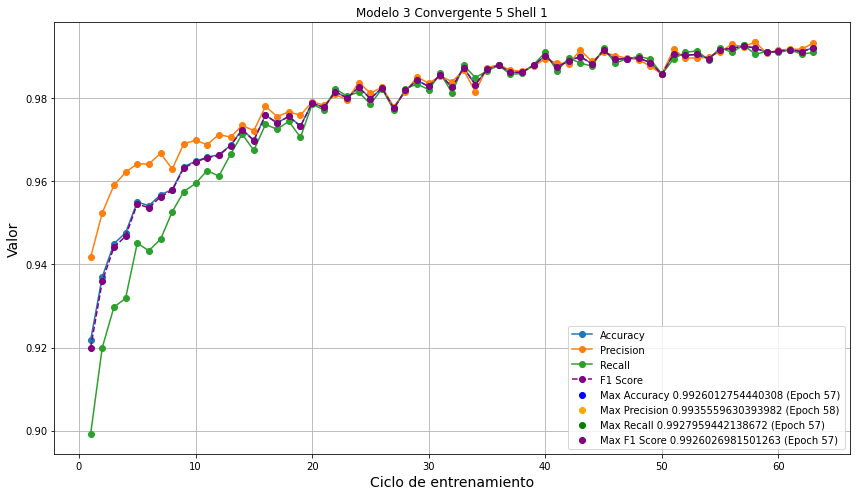

Highest Accuracy: 0.9926012754440308 at Epoch 57
Highest Precision: 0.9935559630393982 at Epoch 58
Highest Recall: 0.9927959442138672 at Epoch 57
Highest F1 Score: 0.9926026981501263 at Epoch 57


In [2]:
#MODELO 3 CONVERGENTE 5 EPOCHS CLUSTER SHELL 1
metrica_direccion=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\metricas_modelos_cluster\metricas_modelo3_convergente5.txt"
metrica=pd.read_csv(metrica_direccion)
epochs=list(metrica["Epoch"])
accuracy=list(metrica["accuracy"])
precision=list(metrica["precision"])
recall=list(metrica["recall"])
f1_score = [2 * (p * r) / (p + r) if (p + r) > 0 else 0 for p, r in zip(precision, recall)]

# Find the epoch with the highest F1 score
max_f1_epoch = f1_score.index(max(f1_score)) + 1

# Plot the metrics
plt.figure(figsize=(12, 7))
plt.plot(epochs, accuracy, label='Accuracy', marker='o')
plt.plot(epochs, precision, label='Precision', marker='o')
plt.plot(epochs, recall, label='Recall', marker='o')
plt.plot(epochs, f1_score, label='F1 Score', marker='o', linestyle='--', color='purple')

# Highlight the highest points
max_acc_epoch = accuracy.index(max(accuracy)) + 1
max_prec_epoch = precision.index(max(precision)) + 1
max_recall_epoch = recall.index(max(recall)) + 1

plt.scatter(max_acc_epoch, max(accuracy), color='blue', label=f"Max Accuracy {max(accuracy)} (Epoch {max_acc_epoch})")
plt.scatter(max_prec_epoch, max(precision), color='orange', label=f"Max Precision {max(precision)} (Epoch {max_prec_epoch})")
plt.scatter(max_recall_epoch, max(recall), color='green', label=f"Max Recall {max(recall)} (Epoch {max_recall_epoch})")
plt.scatter(max_f1_epoch, max(f1_score), color='purple', label=f"Max F1 Score {max(f1_score)} (Epoch {max_f1_epoch})")

# Add labels, legend, and title
#plt.title("Metrics Across Epochs for Model 1 (No second Dense Layer, 100 Layers)", fontsize=16)
plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("Valor", fontsize=14)
plt.title("Modelo 3 Convergente 5 Shell 1")
#plt.xticks(epochs)
plt.legend()
plt.grid(True)
plt.tight_layout()

# Show the plot
plt.show()

# Print the highest values and their epochs
print(f"Highest Accuracy: {max(accuracy)} at Epoch {max_acc_epoch}")
print(f"Highest Precision: {max(precision)} at Epoch {max_prec_epoch}")
print(f"Highest Recall: {max(recall)} at Epoch {max_recall_epoch}")
print(f"Highest F1 Score: {max(f1_score)} at Epoch {max_f1_epoch}")

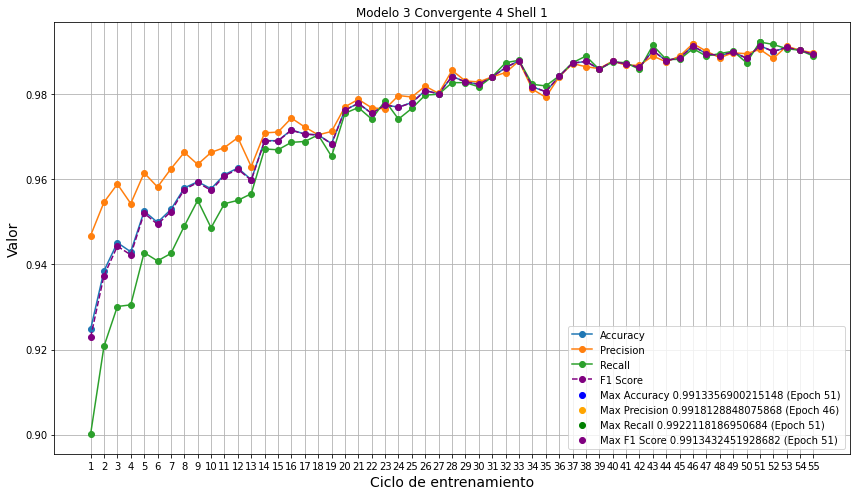

Highest Accuracy: 0.9913356900215148 at Epoch 51
Highest Precision: 0.9918128848075868 at Epoch 46
Highest Recall: 0.9922118186950684 at Epoch 51
Highest F1 Score: 0.9913432451928682 at Epoch 51


In [3]:
#MODELO 3 CONVERGENTE 4 EPOCHS CLUSTER SHELL 1
metrica_direccion=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\metricas_modelos_cluster\metricas_modelo3_convergente4.txt"
metrica=pd.read_csv(metrica_direccion)
epochs=list(metrica["Epoch"])
accuracy=list(metrica["accuracy"])
precision=list(metrica["precision"])
recall=list(metrica["recall"])
f1_score = [2 * (p * r) / (p + r) if (p + r) > 0 else 0 for p, r in zip(precision, recall)]

# Find the epoch with the highest F1 score
max_f1_epoch = f1_score.index(max(f1_score)) + 1

# Plot the metrics
plt.figure(figsize=(12, 7))
plt.plot(epochs, accuracy, label='Accuracy', marker='o')
plt.plot(epochs, precision, label='Precision', marker='o')
plt.plot(epochs, recall, label='Recall', marker='o')
plt.plot(epochs, f1_score, label='F1 Score', marker='o', linestyle='--', color='purple')

# Highlight the highest points
max_acc_epoch = accuracy.index(max(accuracy)) + 1
max_prec_epoch = precision.index(max(precision)) + 1
max_recall_epoch = recall.index(max(recall)) + 1

plt.scatter(max_acc_epoch, max(accuracy), color='blue', label=f"Max Accuracy {max(accuracy)} (Epoch {max_acc_epoch})")
plt.scatter(max_prec_epoch, max(precision), color='orange', label=f"Max Precision {max(precision)} (Epoch {max_prec_epoch})")
plt.scatter(max_recall_epoch, max(recall), color='green', label=f"Max Recall {max(recall)} (Epoch {max_recall_epoch})")
plt.scatter(max_f1_epoch, max(f1_score), color='purple', label=f"Max F1 Score {max(f1_score)} (Epoch {max_f1_epoch})")

# Add labels, legend, and title
#plt.title("Metrics Across Epochs for Model 1 (No second Dense Layer, 100 Layers)", fontsize=16)
plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("Valor", fontsize=14)
plt.title("Modelo 3 Convergente 4 Shell 1")
plt.xticks(epochs)
plt.legend()
plt.grid(True)
plt.tight_layout()

# Show the plot
plt.show()

# Print the highest values and their epochs
print(f"Highest Accuracy: {max(accuracy)} at Epoch {max_acc_epoch}")
print(f"Highest Precision: {max(precision)} at Epoch {max_prec_epoch}")
print(f"Highest Recall: {max(recall)} at Epoch {max_recall_epoch}")
print(f"Highest F1 Score: {max(f1_score)} at Epoch {max_f1_epoch}")

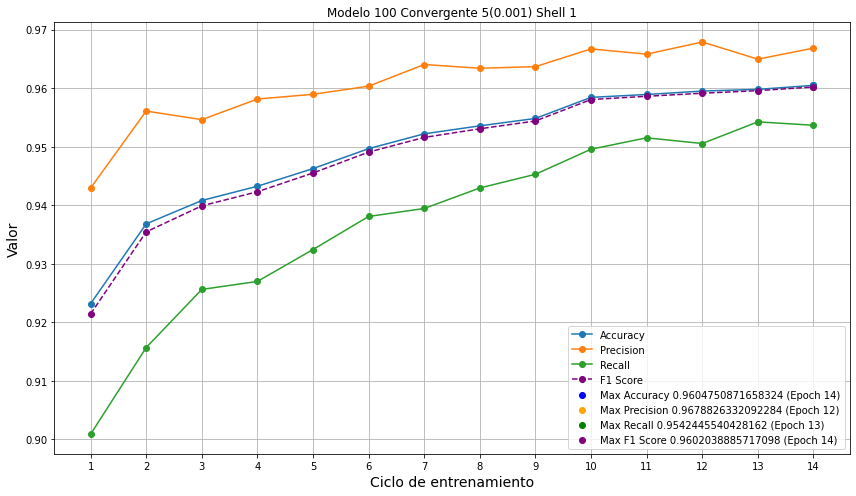

Highest Accuracy: 0.9604750871658324 at Epoch 14
Highest Precision: 0.9678826332092284 at Epoch 12
Highest Recall: 0.9542445540428162 at Epoch 13
Highest F1 Score: 0.9602038885717098 at Epoch 14


In [16]:
#MODELO 100 CONVERGENTE 5 (0.001) EPOCHS CLUSTER SHELL 1
metrica_direccion=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\metricas_modelos_cluster\metricas_modelo100_convergente5.txt"
metrica=pd.read_csv(metrica_direccion)
epochs=list(metrica["Epoch"])
accuracy=list(metrica["accuracy"])
precision=list(metrica["precision"])
recall=list(metrica["recall"])
f1_score = [2 * (p * r) / (p + r) if (p + r) > 0 else 0 for p, r in zip(precision, recall)]

# Find the epoch with the highest F1 score
max_f1_epoch = f1_score.index(max(f1_score)) + 1

# Plot the metrics
plt.figure(figsize=(12, 7))
plt.plot(epochs, accuracy, label='Accuracy', marker='o')
plt.plot(epochs, precision, label='Precision', marker='o')
plt.plot(epochs, recall, label='Recall', marker='o')
plt.plot(epochs, f1_score, label='F1 Score', marker='o', linestyle='--', color='purple')

# Highlight the highest points
max_acc_epoch = accuracy.index(max(accuracy)) + 1
max_prec_epoch = precision.index(max(precision)) + 1
max_recall_epoch = recall.index(max(recall)) + 1

plt.scatter(max_acc_epoch, max(accuracy), color='blue', label=f"Max Accuracy {max(accuracy)} (Epoch {max_acc_epoch})")
plt.scatter(max_prec_epoch, max(precision), color='orange', label=f"Max Precision {max(precision)} (Epoch {max_prec_epoch})")
plt.scatter(max_recall_epoch, max(recall), color='green', label=f"Max Recall {max(recall)} (Epoch {max_recall_epoch})")
plt.scatter(max_f1_epoch, max(f1_score), color='purple', label=f"Max F1 Score {max(f1_score)} (Epoch {max_f1_epoch})")

# Add labels, legend, and title
#plt.title("Metrics Across Epochs for Model 1 (No second Dense Layer, 100 Layers)", fontsize=16)
plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("Valor", fontsize=14)
plt.title("Modelo 100 Convergente 5(0.001) Shell 1")
plt.xticks(epochs)
plt.legend()
plt.grid(True)
plt.tight_layout()
#plt.xscale("log")
# Show the plot
plt.show()

# Print the highest values and their epochs
print(f"Highest Accuracy: {max(accuracy)} at Epoch {max_acc_epoch}")
print(f"Highest Precision: {max(precision)} at Epoch {max_prec_epoch}")
print(f"Highest Recall: {max(recall)} at Epoch {max_recall_epoch}")
print(f"Highest F1 Score: {max(f1_score)} at Epoch {max_f1_epoch}")

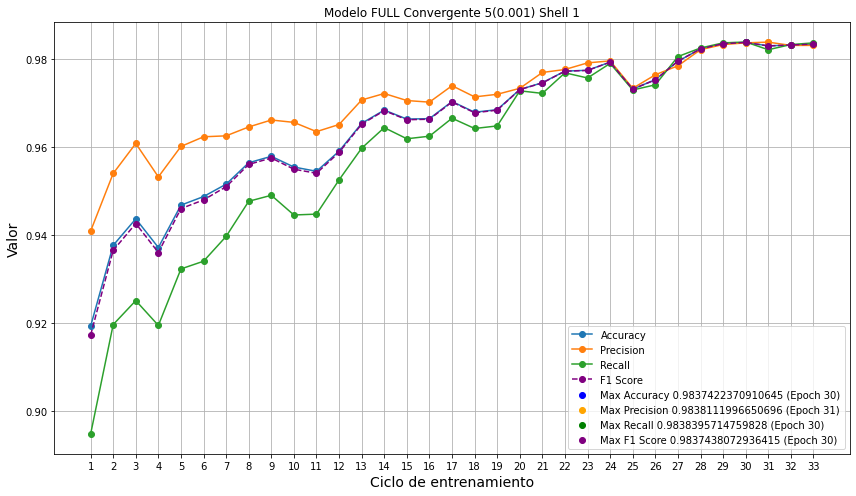

Highest Accuracy: 0.9837422370910645 at Epoch 30
Highest Precision: 0.9838111996650696 at Epoch 31
Highest Recall: 0.9838395714759828 at Epoch 30
Highest F1 Score: 0.9837438072936415 at Epoch 30


In [17]:
#MODELO FULL CONVERGENTE 5 (0.001) EPOCHS CLUSTER SHELL 1
metrica_direccion=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\metricas_modelos_cluster\metricas_modeloFull_convergente5.txt"
metrica=pd.read_csv(metrica_direccion)
epochs=list(metrica["Epoch"])
accuracy=list(metrica["accuracy"])
precision=list(metrica["precision"])
recall=list(metrica["recall"])
f1_score = [2 * (p * r) / (p + r) if (p + r) > 0 else 0 for p, r in zip(precision, recall)]

# Find the epoch with the highest F1 score
max_f1_epoch = f1_score.index(max(f1_score)) + 1

# Plot the metrics
plt.figure(figsize=(12, 7))
plt.plot(epochs, accuracy, label='Accuracy', marker='o')
plt.plot(epochs, precision, label='Precision', marker='o')
plt.plot(epochs, recall, label='Recall', marker='o')
plt.plot(epochs, f1_score, label='F1 Score', marker='o', linestyle='--', color='purple')

# Highlight the highest points
max_acc_epoch = accuracy.index(max(accuracy)) + 1
max_prec_epoch = precision.index(max(precision)) + 1
max_recall_epoch = recall.index(max(recall)) + 1

plt.scatter(max_acc_epoch, max(accuracy), color='blue', label=f"Max Accuracy {max(accuracy)} (Epoch {max_acc_epoch})")
plt.scatter(max_prec_epoch, max(precision), color='orange', label=f"Max Precision {max(precision)} (Epoch {max_prec_epoch})")
plt.scatter(max_recall_epoch, max(recall), color='green', label=f"Max Recall {max(recall)} (Epoch {max_recall_epoch})")
plt.scatter(max_f1_epoch, max(f1_score), color='purple', label=f"Max F1 Score {max(f1_score)} (Epoch {max_f1_epoch})")

# Add labels, legend, and title
#plt.title("Metrics Across Epochs for Model 1 (No second Dense Layer, 100 Layers)", fontsize=16)
plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("Valor", fontsize=14)
plt.title("Modelo FULL Convergente 5(0.001) Shell 1")
plt.xticks(epochs)
plt.legend()
plt.grid(True)
plt.tight_layout()
#plt.xscale("log")
# Show the plot
plt.show()

# Print the highest values and their epochs
print(f"Highest Accuracy: {max(accuracy)} at Epoch {max_acc_epoch}")
print(f"Highest Precision: {max(precision)} at Epoch {max_prec_epoch}")
print(f"Highest Recall: {max(recall)} at Epoch {max_recall_epoch}")
print(f"Highest F1 Score: {max(f1_score)} at Epoch {max_f1_epoch}")

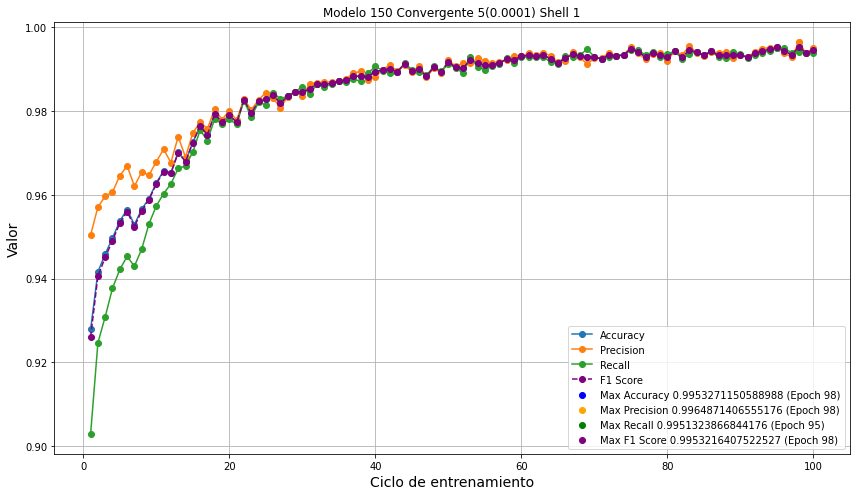

Highest Accuracy: 0.9953271150588988 at Epoch 98
Highest Precision: 0.9964871406555176 at Epoch 98
Highest Recall: 0.9951323866844176 at Epoch 95
Highest F1 Score: 0.9953216407522527 at Epoch 98


In [89]:
#MODELO 3 CONVERGENTE 5 (0.0001) EPOCHS CLUSTER SHELL 1
metrica_direccion=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\metricas_modelos_cluster\metricas_modelo150_00001_convergente5.txt"
metrica=pd.read_csv(metrica_direccion)
epochs=list(metrica["Epoch"])
accuracy=list(metrica["accuracy"])
precision=list(metrica["precision"])
recall=list(metrica["recall"])
f1_score = [2 * (p * r) / (p + r) if (p + r) > 0 else 0 for p, r in zip(precision, recall)]

# Find the epoch with the highest F1 score
max_f1_epoch = f1_score.index(max(f1_score)) + 1

# Plot the metrics
plt.figure(figsize=(12, 7))
plt.plot(epochs, accuracy, label='Accuracy', marker='o')
plt.plot(epochs, precision, label='Precision', marker='o')
plt.plot(epochs, recall, label='Recall', marker='o')
plt.plot(epochs, f1_score, label='F1 Score', marker='o', linestyle='--', color='purple')

# Highlight the highest points
max_acc_epoch = accuracy.index(max(accuracy)) + 1
max_prec_epoch = precision.index(max(precision)) + 1
max_recall_epoch = recall.index(max(recall)) + 1

plt.scatter(max_acc_epoch, max(accuracy), color='blue', label=f"Max Accuracy {max(accuracy)} (Epoch {max_acc_epoch})")
plt.scatter(max_prec_epoch, max(precision), color='orange', label=f"Max Precision {max(precision)} (Epoch {max_prec_epoch})")
plt.scatter(max_recall_epoch, max(recall), color='green', label=f"Max Recall {max(recall)} (Epoch {max_recall_epoch})")
plt.scatter(max_f1_epoch, max(f1_score), color='purple', label=f"Max F1 Score {max(f1_score)} (Epoch {max_f1_epoch})")

# Add labels, legend, and title
#plt.title("Metrics Across Epochs for Model 1 (No second Dense Layer, 100 Layers)", fontsize=16)
plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("Valor", fontsize=14)
plt.title("Modelo 150 Convergente 5(0.0001) Shell 1")
#plt.xticks(epochs)
plt.legend()
plt.grid(True)
plt.tight_layout()
#plt.xscale("log")
# Show the plot
plt.show()

# Print the highest values and their epochs
print(f"Highest Accuracy: {max(accuracy)} at Epoch {max_acc_epoch}")
print(f"Highest Precision: {max(precision)} at Epoch {max_prec_epoch}")
print(f"Highest Recall: {max(recall)} at Epoch {max_recall_epoch}")
print(f"Highest F1 Score: {max(f1_score)} at Epoch {max_f1_epoch}")

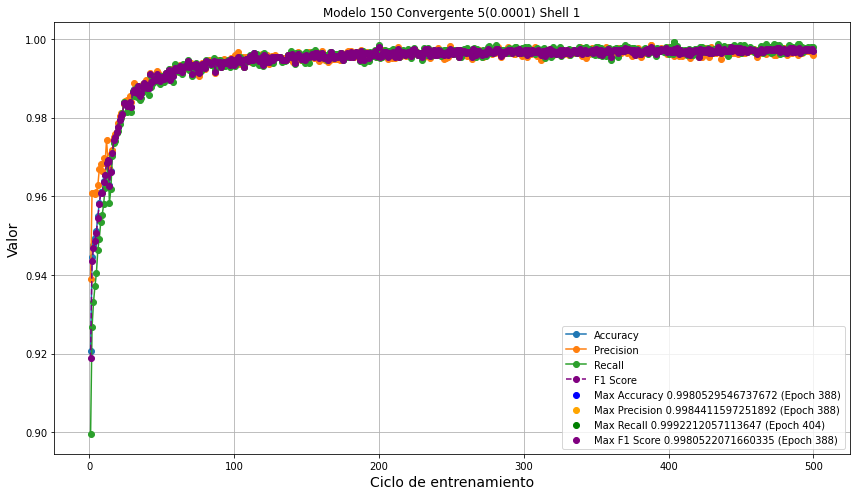

Highest Accuracy: 0.9980529546737672 at Epoch 388
Highest Precision: 0.9984411597251892 at Epoch 388
Highest Recall: 0.9992212057113647 at Epoch 404
Highest F1 Score: 0.9980522071660335 at Epoch 388


In [4]:
#MODELO 150 CONVERGENTE 5 (0.0001) 500 EPOCHS CLUSTER SHELL 1
metrica_direccion=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\metricas_modelos_cluster\metricas_modelo150_00001_convergente5LIMITE500.txt"
metrica=pd.read_csv(metrica_direccion)
epochs=list(metrica["Epoch"])
accuracy=list(metrica["accuracy"])
precision=list(metrica["precision"])
recall=list(metrica["recall"])
f1_score = [2 * (p * r) / (p + r) if (p + r) > 0 else 0 for p, r in zip(precision, recall)]

# Find the epoch with the highest F1 score
max_f1_epoch = f1_score.index(max(f1_score)) + 1

# Plot the metrics
plt.figure(figsize=(12, 7))
plt.plot(epochs, accuracy, label='Accuracy', marker='o')
plt.plot(epochs, precision, label='Precision', marker='o')
plt.plot(epochs, recall, label='Recall', marker='o')
plt.plot(epochs, f1_score, label='F1 Score', marker='o', linestyle='--', color='purple')

# Highlight the highest points
max_acc_epoch = accuracy.index(max(accuracy)) + 1
max_prec_epoch = precision.index(max(precision)) + 1
max_recall_epoch = recall.index(max(recall)) + 1

plt.scatter(max_acc_epoch, max(accuracy), color='blue', label=f"Max Accuracy {max(accuracy)} (Epoch {max_acc_epoch})")
plt.scatter(max_prec_epoch, max(precision), color='orange', label=f"Max Precision {max(precision)} (Epoch {max_prec_epoch})")
plt.scatter(max_recall_epoch, max(recall), color='green', label=f"Max Recall {max(recall)} (Epoch {max_recall_epoch})")
plt.scatter(max_f1_epoch, max(f1_score), color='purple', label=f"Max F1 Score {max(f1_score)} (Epoch {max_f1_epoch})")

# Add labels, legend, and title
#plt.title("Metrics Across Epochs for Model 1 (No second Dense Layer, 100 Layers)", fontsize=16)
plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("Valor", fontsize=14)
plt.title("Modelo 150 Convergente 5(0.0001) Shell 1")
#plt.xticks(epochs)
#plt.xscale("log")
plt.legend()
plt.grid(True)
plt.tight_layout()
#plt.xscale("log")
# Show the plot
plt.show()

# Print the highest values and their epochs
print(f"Highest Accuracy: {max(accuracy)} at Epoch {max_acc_epoch}")
print(f"Highest Precision: {max(precision)} at Epoch {max_prec_epoch}")
print(f"Highest Recall: {max(recall)} at Epoch {max_recall_epoch}")
print(f"Highest F1 Score: {max(f1_score)} at Epoch {max_f1_epoch}")

### Modelos Convergentes (Diferencias y Derivadas)

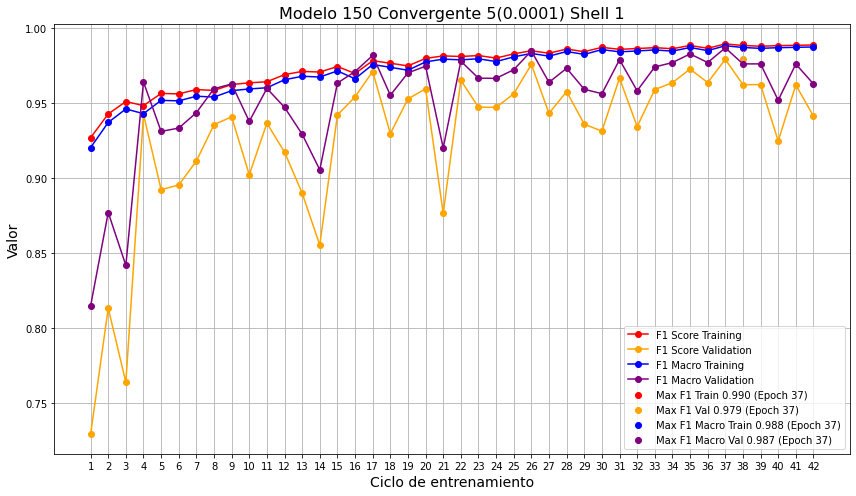

Highest F1 Score (Training): 0.9896 at Epoch 37
Highest F1 Score (Validation): 0.9793 at Epoch 37
Highest F1 Macro (Training): 0.9884 at Epoch 37
Highest F1 Macro (Validation): 0.9870 at Epoch 37


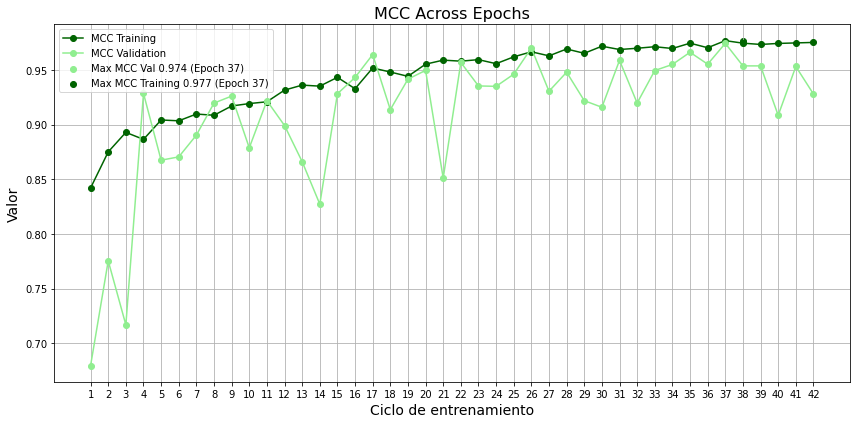

Highest MCC Training: 0.9768 at Epoch 37
Highest MCC Validation: 0.9744 at Epoch 37


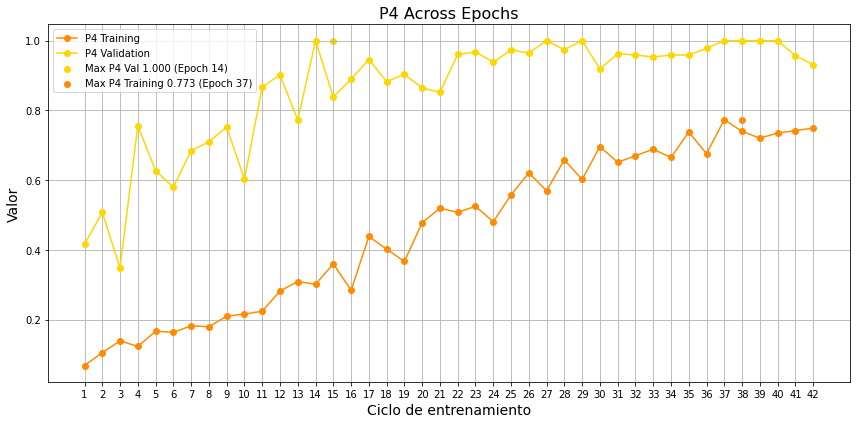

Highest P4 Training: 0.7735 at Epoch 37
Highest P4 Validation: 1.0000 at Epoch 14


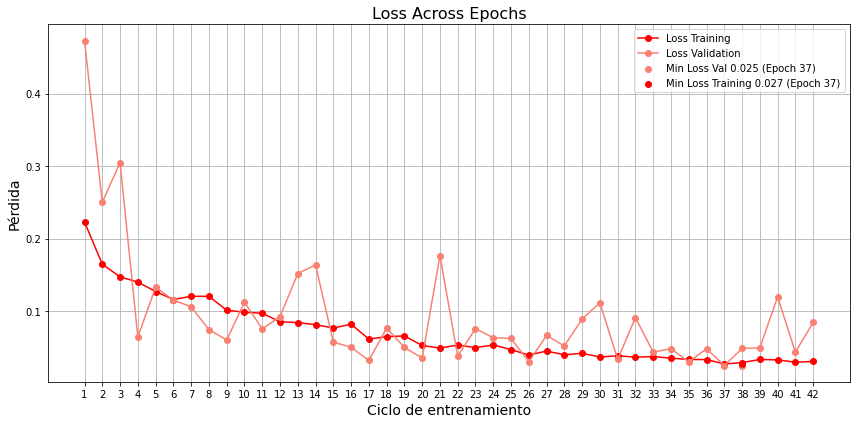

Lowest Loss Training: 0.0271 at Epoch 37
Lowest Loss Validation: 0.0248 at Epoch 37


In [12]:
#MODELO 150 CONVERGENTE 5 (Derivada + Diferencias de F1 Score y F1 Macro) + Validation Set SHELL 1
#Hiperparametros
#Batch Size=32
#Capas Inception= 150
#F1 Score and Macro Stability: 5 Diferencias: 0.001, Derivadas: 0.000005
#Condiciones minimas: 2
metrica_direccion=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\metricas_modelos_cluster\metricas_modelo150_F1ScoreDerivate5OTRO.txt"
metrica=pd.read_csv(metrica_direccion)
#print(metrica.tail(1))
metrica = metrica.drop(metrica.index[-1])
epochs=list(metrica["Epoch"])
#Training Dataset
accuracy_training=list(metrica["accuracy"])
precision_training=list(metrica["precision"])
recall_training=list(metrica["recall"])
loss_training=list(metrica["loss"])
P4_training=list(metrica["P4"])
MCC_training = [float(s[83:-2]) for s in metrica["MCC"]]
F1_score_training=list(metrica["F1_score"])
F1_MACRO_training=list(metrica["F1_macro"])

#Validation Set
accuracy_validation=list(metrica["val_accuracy"])
precision_validation=list(metrica["val_precision"])
recall_validation=list(metrica["val_recall"])
loss_validation=list(metrica["val_loss"])
F1_score_validation = [2 * (p * r) / (p + r) if (p + r) > 0 else 0 for p, r in zip(precision_validation, recall_validation)]
tp=list(metrica["val_tp"])
tn=list(metrica["val_tn"])
fp=list(metrica["val_fp"])
fn=list(metrica["val_fn"])
precision_neg = [tn / (tn + fn) for tn, fn in zip(tn,fn)]
recall_neg = [tn / (tn + fp) for tn, fp in zip(tn,fp)]
F1_neg=[2 * (p * r) / (p + r) if (p + r) > 0 else 0 for p, r in zip(precision_neg, recall_neg)]
F1_MACRO_validation=[(pos+neg)/2 for pos, neg in zip(F1_score_validation, F1_neg)]
P4_validation= [(4* tp* tn)/(4* tp* tn + (tp+tn) * (fp*fn)) for tp,tn,fp,fn in zip(tp,tn,fp,fn)]
MCC_validation=[(tp * tn - fp * fn)/(tf.sqrt((tp + fp) * (tp + fn) * (tn + fp) * (tn + fn))) for tp,tn,fp,fn in zip(tp,tn,fp,fn)]

# Plot the F1
plt.figure(figsize=(12, 7))

# Plot the F1 metrics
plt.plot(epochs, F1_score_training, label='F1 Score Training', marker='o', color='red')
plt.plot(epochs, F1_score_validation, label='F1 Score Validation', marker='o', color='orange')
plt.plot(epochs, F1_MACRO_training, label='F1 Macro Training', marker='o', color='blue')
plt.plot(epochs, F1_MACRO_validation, label='F1 Macro Validation', marker='o', color='purple')

# Find max values and epochs
max_f1_epoch = F1_score_training.index(max(F1_score_training)) + 1
max_f1_val_epoch = F1_score_validation.index(max(F1_score_validation)) + 1
max_f1_macro_epoch = F1_MACRO_training.index(max(F1_MACRO_training)) + 1
max_f1_macro_val_epoch = F1_MACRO_validation.index(max(F1_MACRO_validation)) + 1

# Highlight maxima
plt.scatter(max_f1_epoch, max(F1_score_training), color='red', label=f"Max F1 Train {max(F1_score_training):.3f} (Epoch {max_f1_epoch})")
plt.scatter(max_f1_val_epoch, max(F1_score_validation), color='orange', label=f"Max F1 Val {max(F1_score_validation):.3f} (Epoch {max_f1_val_epoch})")
plt.scatter(max_f1_macro_epoch, max(F1_MACRO_training), color='blue', label=f"Max F1 Macro Train {max(F1_MACRO_training):.3f} (Epoch {max_f1_macro_epoch})")
plt.scatter(max_f1_macro_val_epoch, max(F1_MACRO_validation), color='purple', label=f"Max F1 Macro Val {max(F1_MACRO_validation):.3f} (Epoch {max_f1_macro_val_epoch})")

# Labels, title, legend
plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("Valor", fontsize=14)
plt.title("Modelo 150 Convergente 5(0.0001) Shell 1", fontsize=16)
plt.legend(loc='best', fontsize=10)
plt.grid(True)
plt.tight_layout()
# plt.xscale("log") # Optional

# Show plot
plt.show()

# Print summary
print(f"Highest F1 Score (Training): {max(F1_score_training):.4f} at Epoch {max_f1_epoch}")
print(f"Highest F1 Score (Validation): {max(F1_score_validation):.4f} at Epoch {max_f1_val_epoch}")
print(f"Highest F1 Macro (Training): {max(F1_MACRO_training):.4f} at Epoch {max_f1_macro_epoch}")
print(f"Highest F1 Macro (Validation): {max(F1_MACRO_validation):.4f} at Epoch {max_f1_macro_val_epoch}")


# ----------- 2. Plot MCC -------------------------
max_mcc_val_epoch = MCC_validation.index(max(MCC_validation)) + 1
max_mcc_training_epoch=MCC_training.index(max(MCC_training))+1
plt.figure(figsize=(12, 6))
plt.plot(epochs, MCC_training, label='MCC Training', marker='o', color='darkgreen')
plt.plot(epochs, MCC_validation, label='MCC Validation', marker='o', color='lightgreen')

plt.scatter(max_mcc_val_epoch, max(MCC_validation), color='lightgreen', label=f"Max MCC Val {max(MCC_validation):.3f} (Epoch {max_mcc_val_epoch})")
plt.scatter(max_mcc_training_epoch, max(MCC_training), color='darkgreen', label=f"Max MCC Training {max(MCC_training):.3f} (Epoch {max_mcc_training_epoch})")

plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("Valor", fontsize=14)
plt.title("MCC Across Epochs", fontsize=16)
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()
print(f"Highest MCC Training: {max(MCC_training):.4f} at Epoch {max_mcc_training_epoch}")
print(f"Highest MCC Validation: {max(MCC_validation):.4f} at Epoch {max_mcc_val_epoch}")
# ----------- 3. Plot P4 -------------------------
max_p4_val_epoch = P4_validation.index(max(P4_validation))+1
max_p4_training_epoch = P4_training.index(max(P4_training))+1
plt.figure(figsize=(12, 6))
plt.plot(epochs, P4_training, label='P4 Training', marker='o', color='darkorange')
plt.plot(epochs, P4_validation, label='P4 Validation', marker='o', color='gold')

plt.scatter(max_p4_val_epoch, max(P4_validation), color='gold',
            label=f"Max P4 Val {max(P4_validation):.3f} (Epoch {max_p4_val_epoch})")
plt.scatter(max_p4_training_epoch, max(P4_training), color='darkorange',
            label=f"Max P4 Training {max(P4_training):.3f} (Epoch {max_p4_training_epoch})")
plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("Valor", fontsize=14)
plt.title("P4 Across Epochs", fontsize=16)
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()
print(f"Highest P4 Training: {max(P4_training):.4f} at Epoch {max_p4_training_epoch}")
print(f"Highest P4 Validation: {max(P4_validation):.4f} at Epoch {max_p4_val_epoch}")

# ----------- 4. Plot Loss -------------------------------
min_loss_val_epoch = loss_validation.index(min(loss_validation)) +1
min_loss_training_epoch = loss_training.index(min(loss_training)) +1
plt.figure(figsize=(12, 6))
plt.plot(epochs, loss_training, label='Loss Training', marker='o', color='red')
plt.plot(epochs, loss_validation, label='Loss Validation', marker='o', color='salmon')

plt.scatter(min_loss_val_epoch, min(loss_validation), color='salmon',
            label=f"Min Loss Val {min(loss_validation):.3f} (Epoch {min_loss_val_epoch})")
plt.scatter(min_loss_training_epoch, min(loss_training), color='red',
            label=f"Min Loss Training {min(loss_training):.3f} (Epoch {min_loss_training_epoch})")

plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("Pérdida", fontsize=14)
plt.title("Loss Across Epochs", fontsize=16)
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()
print(f"Lowest Loss Training: {min(loss_training):.4f} at Epoch {min_loss_training_epoch}")
print(f"Lowest Loss Validation: {min(loss_validation):.4f} at Epoch {min_loss_val_epoch}")

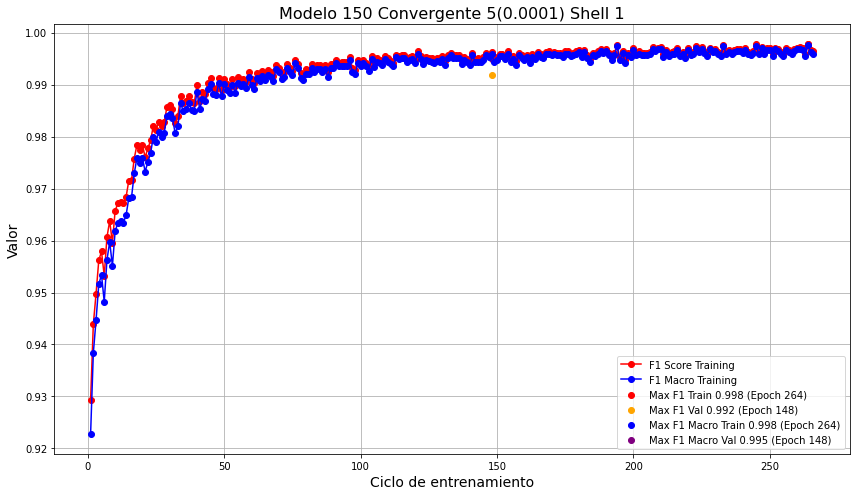

Highest F1 Score (Training): 0.9978 at Epoch 264
Highest F1 Score (Validation): 0.9919 at Epoch 148
Highest F1 Macro (Training): 0.9976 at Epoch 264
Highest F1 Macro (Validation): 0.9949 at Epoch 148


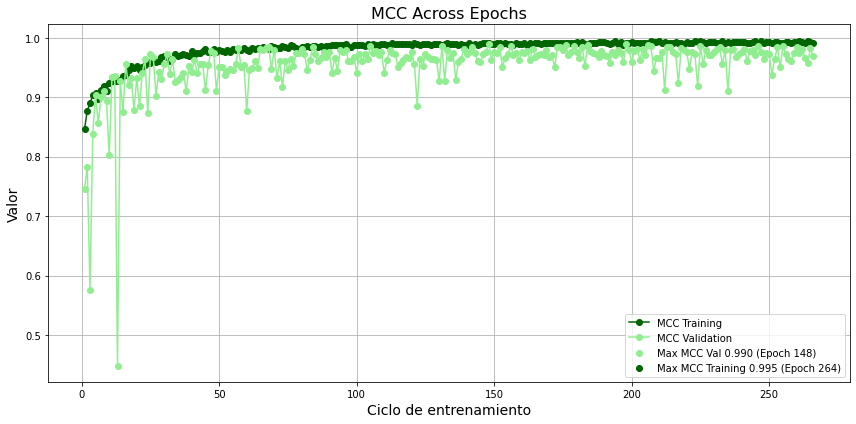

Highest MCC Training: 0.9951 at Epoch 264
Highest MCC Validation: 0.9899 at Epoch 148


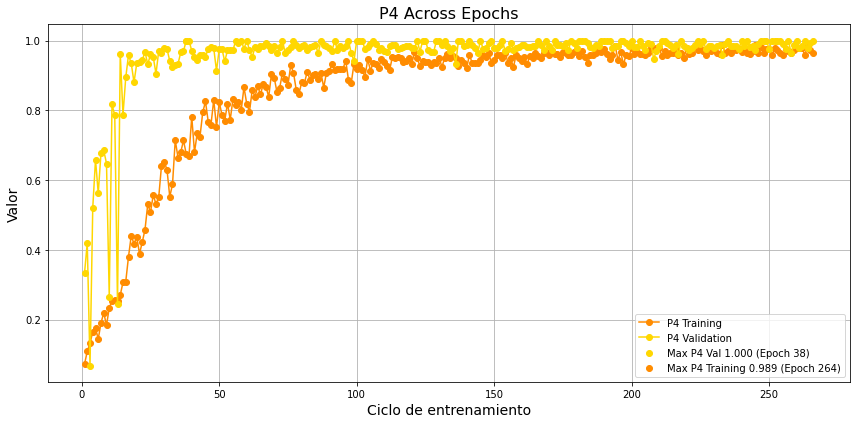

Highest P4 Training: 0.9887 at Epoch 264
Highest P4 Validation: 1.0000 at Epoch 38


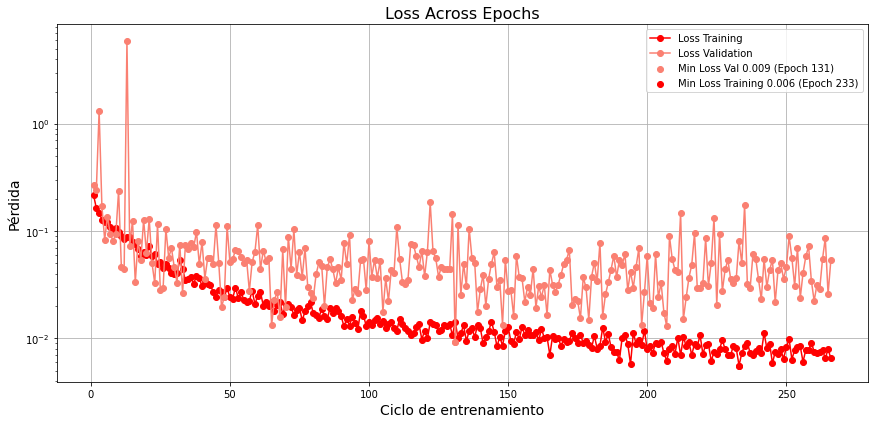

Lowest Loss Training: 0.0056 at Epoch 233
Lowest Loss Validation: 0.0092 at Epoch 131


In [8]:
#MODELO 150 CONVERGENTE 5 (Derivada + Diferencias de F1 Score y F1 Macro) + Validation Set SHELL 1
#Hiperparametros
#Batch Size=32
#Capas Inception= 150
#F1 Score and Macro Stability: 5 Diferencias: 0.001, Derivadas: 0.00005
#Condiciones minimas: 2
metrica_direccion=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\metricas_modelos_cluster\metricas_modelo150_F1ScoreDerivate5OTROESTRICTO.txt"
metrica=pd.read_csv(metrica_direccion)
#print(metrica.tail(1))
metrica = metrica.drop(metrica.index[-1])
epochs=list(metrica["Epoch"])
#Training Dataset
accuracy_training=list(metrica["accuracy"])
precision_training=list(metrica["precision"])
recall_training=list(metrica["recall"])
loss_training=list(metrica["loss"])
P4_training=list(metrica["P4"])
MCC_training = [float(s[83:-2]) for s in metrica["MCC"]]
F1_score_training=list(metrica["F1_score"])
F1_MACRO_training=list(metrica["F1_macro"])

#Validation Set
accuracy_validation=list(metrica["val_accuracy"])
precision_validation=list(metrica["val_precision"])
recall_validation=list(metrica["val_recall"])
loss_validation=list(metrica["val_loss"])
F1_score_validation = [2 * (p * r) / (p + r) if (p + r) > 0 else 0 for p, r in zip(precision_validation, recall_validation)]
tp=list(metrica["val_tp"])
tn=list(metrica["val_tn"])
fp=list(metrica["val_fp"])
fn=list(metrica["val_fn"])
precision_neg = [tn / (tn + fn) for tn, fn in zip(tn,fn)]
recall_neg = [tn / (tn + fp) for tn, fp in zip(tn,fp)]
F1_neg=[2 * (p * r) / (p + r) if (p + r) > 0 else 0 for p, r in zip(precision_neg, recall_neg)]
F1_MACRO_validation=[(pos+neg)/2 for pos, neg in zip(F1_score_validation, F1_neg)]
P4_validation= [(4* tp* tn)/(4* tp* tn + (tp+tn) * (fp*fn)) for tp,tn,fp,fn in zip(tp,tn,fp,fn)]
MCC_validation=[(tp * tn - fp * fn)/(tf.sqrt((tp + fp) * (tp + fn) * (tn + fp) * (tn + fn))) for tp,tn,fp,fn in zip(tp,tn,fp,fn)]

# Plot the F1
plt.figure(figsize=(12, 7))

# Plot the F1 metrics
plt.plot(epochs, F1_score_training, label='F1 Score Training', marker='o', color='red')
#plt.plot(epochs, F1_score_validation, label='F1 Score Validation', marker='o', color='orange')
plt.plot(epochs, F1_MACRO_training, label='F1 Macro Training', marker='o', color='blue')
#plt.plot(epochs, F1_MACRO_validation, label='F1 Macro Validation', marker='o', color='purple')

# Find max values and epochs
max_f1_epoch = F1_score_training.index(max(F1_score_training)) + 1
max_f1_val_epoch = F1_score_validation.index(max(F1_score_validation)) + 1
max_f1_macro_epoch = F1_MACRO_training.index(max(F1_MACRO_training)) + 1
max_f1_macro_val_epoch = F1_MACRO_validation.index(max(F1_MACRO_validation)) + 1

# Highlight maxima
plt.scatter(max_f1_epoch, max(F1_score_training), color='red', label=f"Max F1 Train {max(F1_score_training):.3f} (Epoch {max_f1_epoch})")
plt.scatter(max_f1_val_epoch, max(F1_score_validation), color='orange', label=f"Max F1 Val {max(F1_score_validation):.3f} (Epoch {max_f1_val_epoch})")
plt.scatter(max_f1_macro_epoch, max(F1_MACRO_training), color='blue', label=f"Max F1 Macro Train {max(F1_MACRO_training):.3f} (Epoch {max_f1_macro_epoch})")
plt.scatter(max_f1_macro_val_epoch, max(F1_MACRO_validation), color='purple', label=f"Max F1 Macro Val {max(F1_MACRO_validation):.3f} (Epoch {max_f1_macro_val_epoch})")

# Labels, title, legend
plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("Valor", fontsize=14)
plt.title("Modelo 150 Convergente 5(0.0001) Shell 1", fontsize=16)
plt.legend(loc='best', fontsize=10)
plt.grid(True)
plt.tight_layout()
# plt.xscale("log") # Optional

# Show plot
plt.show()

# Print summary
print(f"Highest F1 Score (Training): {max(F1_score_training):.4f} at Epoch {max_f1_epoch}")
print(f"Highest F1 Score (Validation): {max(F1_score_validation):.4f} at Epoch {max_f1_val_epoch}")
print(f"Highest F1 Macro (Training): {max(F1_MACRO_training):.4f} at Epoch {max_f1_macro_epoch}")
print(f"Highest F1 Macro (Validation): {max(F1_MACRO_validation):.4f} at Epoch {max_f1_macro_val_epoch}")


# ----------- 2. Plot MCC -------------------------
max_mcc_val_epoch = MCC_validation.index(max(MCC_validation)) + 1
max_mcc_training_epoch=MCC_training.index(max(MCC_training))+1
plt.figure(figsize=(12, 6))
plt.plot(epochs, MCC_training, label='MCC Training', marker='o', color='darkgreen')
plt.plot(epochs, MCC_validation, label='MCC Validation', marker='o', color='lightgreen')

plt.scatter(max_mcc_val_epoch, max(MCC_validation), color='lightgreen', label=f"Max MCC Val {max(MCC_validation):.3f} (Epoch {max_mcc_val_epoch})")
plt.scatter(max_mcc_training_epoch, max(MCC_training), color='darkgreen', label=f"Max MCC Training {max(MCC_training):.3f} (Epoch {max_mcc_training_epoch})")

plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("Valor", fontsize=14)
plt.title("MCC Across Epochs", fontsize=16)
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()
print(f"Highest MCC Training: {max(MCC_training):.4f} at Epoch {max_mcc_training_epoch}")
print(f"Highest MCC Validation: {max(MCC_validation):.4f} at Epoch {max_mcc_val_epoch}")
# ----------- 3. Plot P4 -------------------------
max_p4_val_epoch = P4_validation.index(max(P4_validation))+1
max_p4_training_epoch = P4_training.index(max(P4_training))+1
plt.figure(figsize=(12, 6))
plt.plot(epochs, P4_training, label='P4 Training', marker='o', color='darkorange')
plt.plot(epochs, P4_validation, label='P4 Validation', marker='o', color='gold')

plt.scatter(max_p4_val_epoch, max(P4_validation), color='gold',
            label=f"Max P4 Val {max(P4_validation):.3f} (Epoch {max_p4_val_epoch})")
plt.scatter(max_p4_training_epoch, max(P4_training), color='darkorange',
            label=f"Max P4 Training {max(P4_training):.3f} (Epoch {max_p4_training_epoch})")
plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("Valor", fontsize=14)
plt.title("P4 Across Epochs", fontsize=16)
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()
print(f"Highest P4 Training: {max(P4_training):.4f} at Epoch {max_p4_training_epoch}")
print(f"Highest P4 Validation: {max(P4_validation):.4f} at Epoch {max_p4_val_epoch}")

# ----------- 4. Plot Loss -------------------------------
min_loss_val_epoch = loss_validation.index(min(loss_validation)) +1
min_loss_training_epoch = loss_training.index(min(loss_training)) +1
plt.figure(figsize=(12, 6))
plt.plot(epochs, loss_training, label='Loss Training', marker='o', color='red')
plt.plot(epochs, loss_validation, label='Loss Validation', marker='o', color='salmon')

plt.scatter(min_loss_val_epoch, min(loss_validation), color='salmon',
            label=f"Min Loss Val {min(loss_validation):.3f} (Epoch {min_loss_val_epoch})")
plt.scatter(min_loss_training_epoch, min(loss_training), color='red',
            label=f"Min Loss Training {min(loss_training):.3f} (Epoch {min_loss_training_epoch})")

plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("Pérdida", fontsize=14)
plt.title("Loss Across Epochs", fontsize=16)
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.yscale("log")
plt.show()
print(f"Lowest Loss Training: {min(loss_training):.4f} at Epoch {min_loss_training_epoch}")
print(f"Lowest Loss Validation: {min(loss_validation):.4f} at Epoch {min_loss_val_epoch}")

## PRUEBA MODELOS

In [3]:
#modelo_path=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\modelos\modelo1_prueba3.keras"
#modelo_path=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\modelos\modelo3_30ciclos.keras"
#modelo_path=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\modelos\modelo3_convergente5.keras"
#modelo_path=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\modelos\modelo150_00001_convergente5.keras"
#modelo_path=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\modelos\modelo150_00001_convergente5LIMITE500.keras"
modelo_path=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\modelos\modelo150_F1ScoreDerivate5OTRO.keras"
model = tf.keras.models.load_model(modelo_path)

In [4]:
resultados={}
#folder_path = r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\8 Semestre\Proyecto Teorico\Proyecto Teorico 20242\Gaia-DR3-Proyecto-Teorico-20242\data_v2_diagramas\shell1\prueba"
folder_path= r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\Diagramas Shell\shell1"
for file in os.listdir(folder_path):
    img_path=os.path.join(folder_path,file)
    img = image.load_img(img_path, target_size=(253, 385))
 # Preprocessing the image
    x = image.img_to_array(img)
# x = np.true_divide(x, 255)
## Scaling
    x=x/255
    x = np.expand_dims(x, axis=0)
    preds = model.predict(x)
#preds=np.argmax(preds, axis=1)

    print(file+"   :"+str(preds))
    resultados[file]=preds[0][0]

1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step
Q1_cluster_0.csv.png   :[[0.00042268]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step
Q1_cluster_1.csv.png   :[[0.00036655]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step
Q1_cluster_10.csv.png   :[[0.9539437]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step
Q1_cluster_11.csv.png   :[[0.00451631]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step
Q1_cluster_12.csv.png   :[[0.8770259]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step
Q1_cluster_13.csv.png   :[[0.94883937]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step
Q1_cluster_14.csv.png   :[[0.00167962]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step
Q1_cluster_15.csv.png   :[[0.14217986]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step
Q1_cluster_16.csv.png   :[[0.92018366]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step
Q1_cluster_17.csv.png   :[[0.00572627]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step
Q1_cluster_18.csv.png   :[[0.06265093]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step
Q1_cluster_19.csv.png   :[[0.00777063]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step
Q1_cluster_2.csv.png

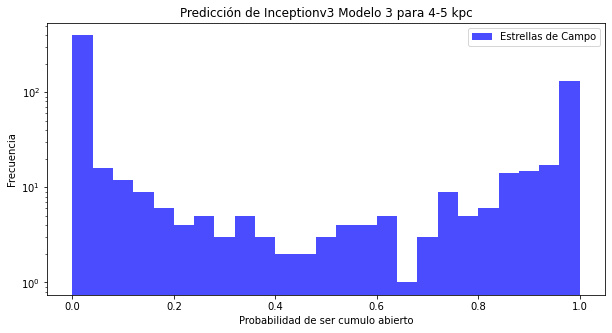

In [5]:
prediccion_shell1=list(resultados.values())
plt.figure(figsize=(10, 5))
plt.hist(prediccion_shell1, bins=25, color='blue', alpha=0.7, label="Estrellas de Campo")
#plt.hist(data_above_threshold, bins=7, color='orange', alpha=0.7, label="Candidatos Cumulos Abiertos")
plt.yscale("log")
# Add labels and legend
plt.xlabel('Probabilidad de ser cumulo abierto')
plt.ylabel('Frecuencia')
plt.title('Predicción de Inceptionv3 Modelo 3 para 4-5 kpc')
plt.legend()

# Show plot
plt.show()

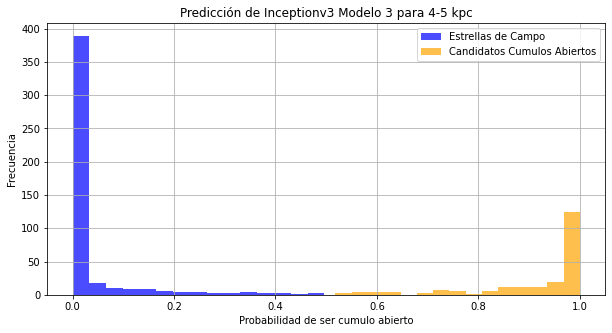

In [6]:
prediccion_shell1=list(resultados.values())
threshold = 0.5

# Split data into two groups
data_below_threshold = [x for x in prediccion_shell1 if x <= threshold]
data_above_threshold = [x for x in prediccion_shell1 if x > threshold]
# Plot histograms
plt.figure(figsize=(10, 5))
plt.hist(data_below_threshold, bins=15, color='blue', alpha=0.7, label="Estrellas de Campo")
plt.hist(data_above_threshold, bins=15, color='orange', alpha=0.7, label="Candidatos Cumulos Abiertos")
#plt.yscale("log")
# Add labels and legend
plt.xlabel('Probabilidad de ser cumulo abierto')
plt.ylabel('Frecuencia')
plt.title('Predicción de Inceptionv3 Modelo 3 para 4-5 kpc')
plt.legend()
plt.grid(True)
# Show plot
plt.show()

In [7]:
cumulos_resultados={}
campo_resultados={}
llaves=resultados.keys()
for x in llaves:
    valor=resultados[x]
    if valor >0.5:
        cumulos_resultados[x]=valor
    else:
        campo_resultados[x]=valor

len(cumulos_resultados), len(campo_resultados)
#Modelo 3:30 Ciclos: (128,552)
#Modelo 3 [150]: 63 Ciclos (Convergencia 5 de 0.001): (137, 543) #####
#Modelo 3 [150]: 100 Ciclos (Convergencia 5 de 0.0001): (150, 530)
#Modelo 3 [150]: 500 Ciclos (Convergencia 5 de 0.0001): (87, 593)
#Modelo 3 [150]: 42 Ciclos (Convergencia 5 de 0.001, Derivadas 5 de 0.00005): (215,465)

(215, 465)

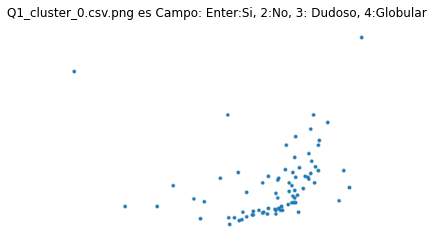

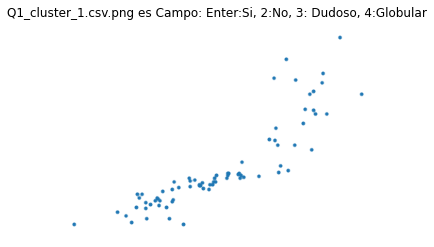

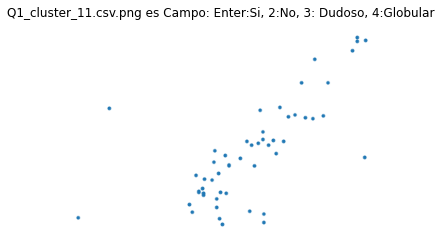

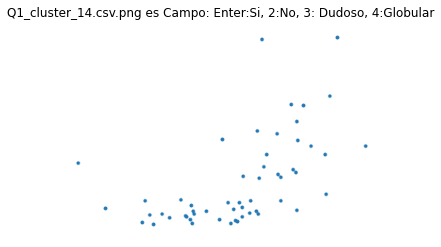

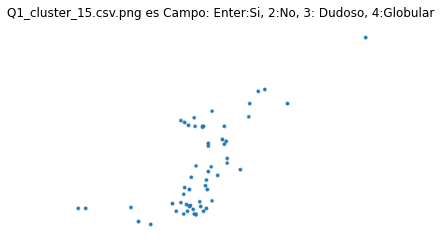

...

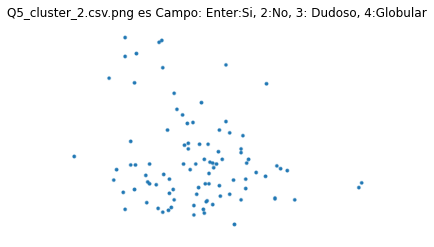

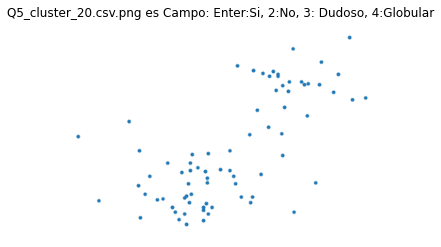

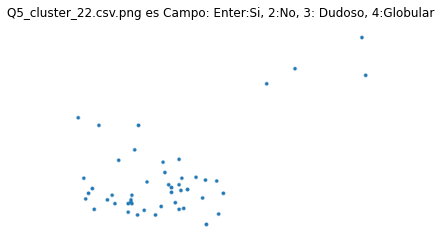

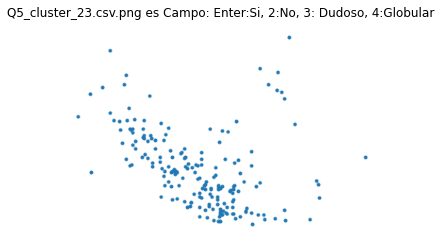

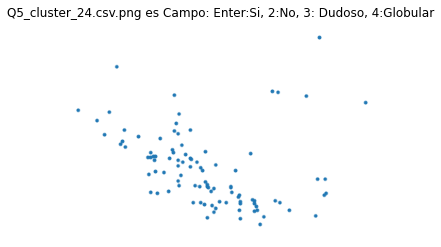

All images have been displayed.


In [8]:
# Folder path and list of image names
folder_path = clasificar_shell1  # Replace with your folder path
image_names = list(campo_resultados.keys())  # Replace with your list of image names

image_names1=image_names[:len(image_names)//2]
image_names2=image_names[len(image_names)//2:]

verificacion_campo={}
for image_name in image_names1:
    # Full path to the image
    image_path = os.path.join(folder_path, image_name)
    
    # Load and display the image
    img = mpimg.imread(image_path)
    plt.imshow(img)
    plt.axis('off')  # Hide axis for better viewing
    plt.title(image_name+" es Campo: Enter:Si, 2:No, 3: Dudoso, 4:Globular")
    plt.show()
    
    # Wait for user input
    while True:
        user_input = input(f"Enter True or False for {image_name}: ")
        if user_input in ["", "2","3", "4"]:
            if user_input=="":
                user_input=["True",campo_resultados[image_name]]
            elif user_input=="2":
                user_input=["False",campo_resultados[image_name]]
            elif user_input=="3":
                user_input=["Dudoso",campo_resultados[image_name]]
            elif user_input=="4":
                user_input=["Globular",campo_resultados[image_name]]
            verificacion_campo[image_name]=user_input
            break  # Proceed to the next image if input is valid
        else:
            print("Please enter either 'True' or 'False'.")

print("All images have been displayed.")


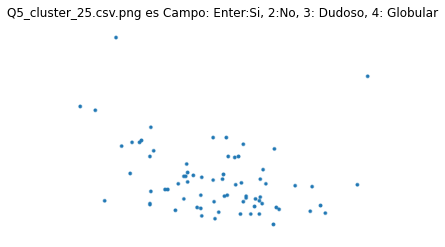

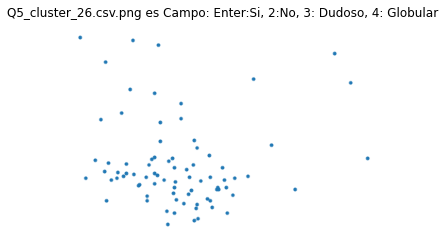

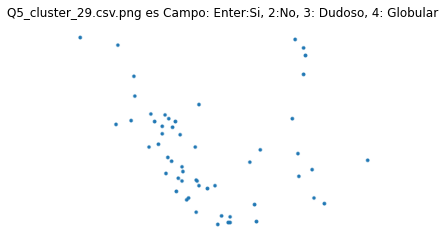

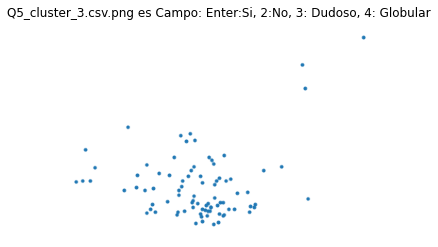

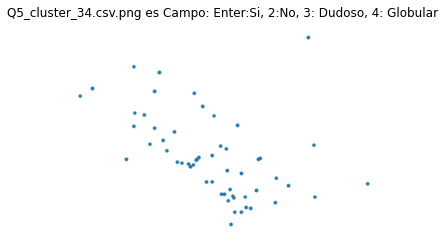

...

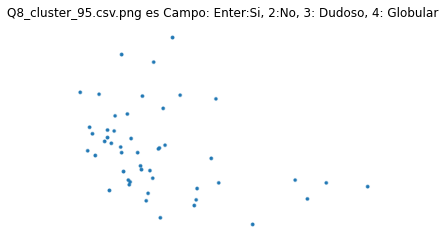

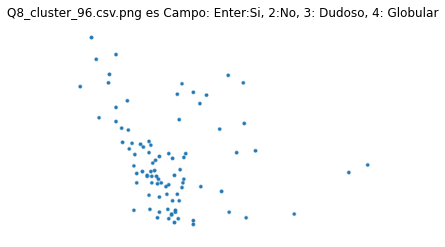

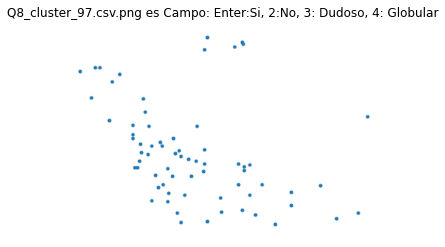

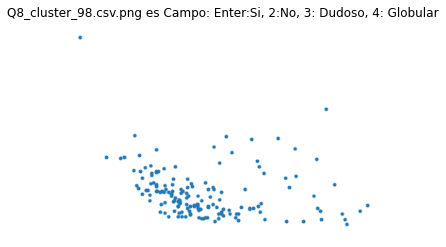

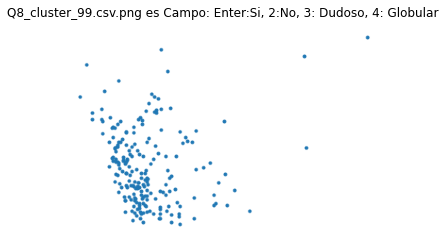

All images have been displayed.


In [9]:
for image_name in image_names2:
    # Full path to the image
    image_path = os.path.join(folder_path, image_name)
    
    # Load and display the image
    img = mpimg.imread(image_path)
    plt.imshow(img)
    plt.axis('off')  # Hide axis for better viewing
    plt.title(image_name+" es Campo: Enter:Si, 2:No, 3: Dudoso, 4: Globular")
    plt.show()
    
    # Wait for user input
    while True:
        user_input = input(f"Enter True or False for {image_name}: ")
        if user_input in ["", "2","3","4"]:
            if user_input=="":
                user_input=["True",campo_resultados[image_name]]
            elif user_input=="2":
                user_input=["False",campo_resultados[image_name]]
            elif user_input=="3":
                user_input=["Dudoso",campo_resultados[image_name]]
            elif user_input=="4":
                user_input=["Globular",campo_resultados[image_name]]
            verificacion_campo[image_name]=user_input
            break  # Proceed to the next image if input is valid
        else:
            print("Please enter either 'True' or 'False'.")

print("All images have been displayed.")


In [10]:
falsos_negativos=0
campos_dudosos=0
globulares_campo=0
for x in verificacion_campo.keys():
    if verificacion_campo[x][0]=="False":
        falsos_negativos+=1
    if verificacion_campo[x][0]=="Dudoso":
        campos_dudosos+=1
    if verificacion_campo[x][0]=="Globular":
        globulares_campo+=1
    
print(falsos_negativos, campos_dudosos, globulares_campo)

3 7 4


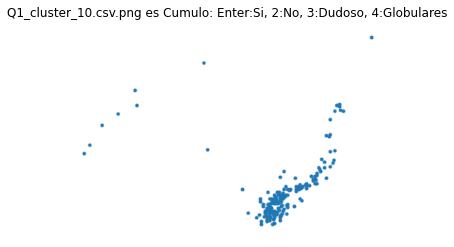

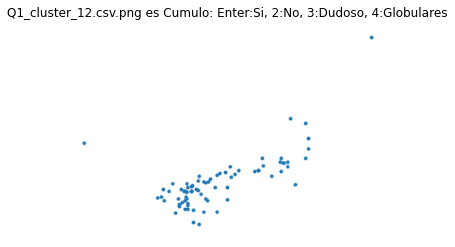

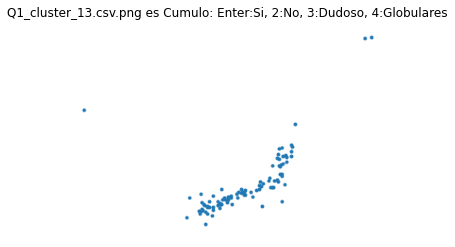

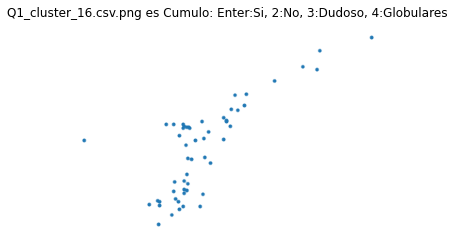

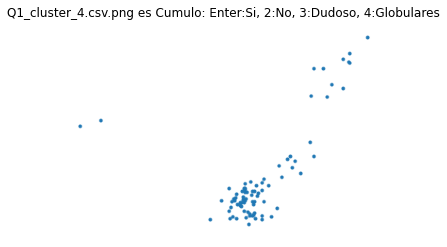

...

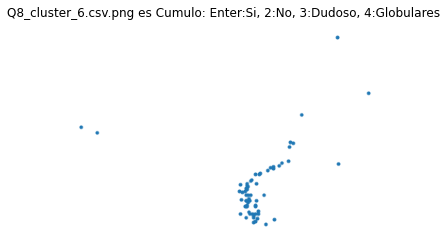

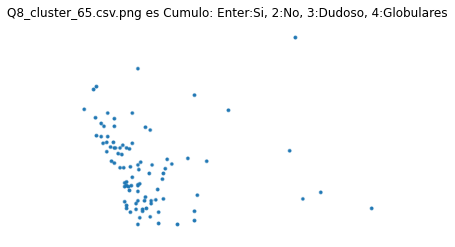

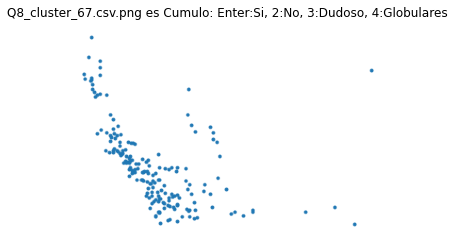

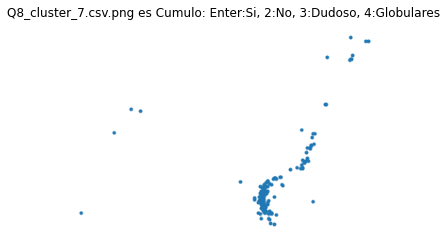

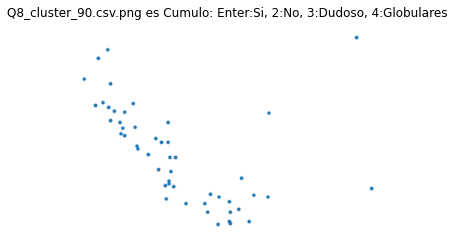

All images have been displayed.


In [11]:
# Folder path and list of image names
folder_path = clasificar_shell1  # Replace with your folder path
image_names = cumulos_resultados.keys()  # Replace with your list of image names
verificacion_cumulo={}
for image_name in image_names:
    # Full path to the image
    image_path = os.path.join(folder_path, image_name)
    
    # Load and display the image
    img = mpimg.imread(image_path)
    plt.imshow(img)
    plt.axis('off')  # Hide axis for better viewing
    plt.title(image_name+" es Cumulo: Enter:Si, 2:No, 3:Dudoso, 4:Globulares")
    plt.show()
    
    # Wait for user input
    while True:
        user_input = input(f"Enter True or False for {image_name}: ")
        if user_input in ["", "2","3","4"]:
            if user_input=="":
                user_input=["True",cumulos_resultados[image_name]]
            elif user_input=="2":
                user_input=["False",cumulos_resultados[image_name]]
            elif user_input=="3":
                user_input=["Dudoso",cumulos_resultados[image_name]]
            elif user_input=="4":
                user_input=["Globular",cumulos_resultados[image_name]]
            verificacion_cumulo[image_name]=user_input
            break  # Proceed to the next image if input is valid
        else:
            print("Please enter either 'True' or 'False'.")

print("All images have been displayed.")


In [12]:
falsos_positivos=0
cumulos_dudosos=0
globulares_cumulos=0
for x in verificacion_cumulo.keys():
    if verificacion_cumulo[x][0]=="False":
        falsos_positivos+=1
    if verificacion_cumulo[x][0]=="Dudoso":
        cumulos_dudosos+=1
    if verificacion_cumulo[x][0]=="Globular":
        globulares_cumulos+=1

print(falsos_positivos, cumulos_dudosos, globulares_cumulos)

51 45 11


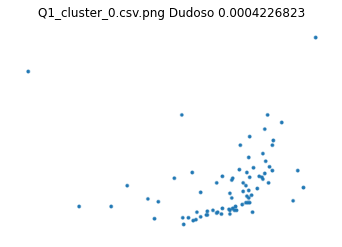

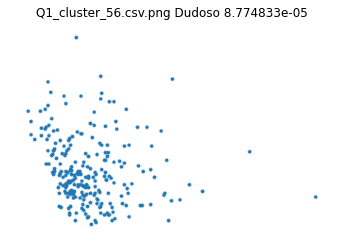

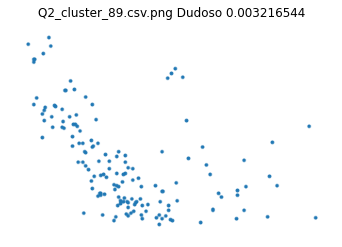

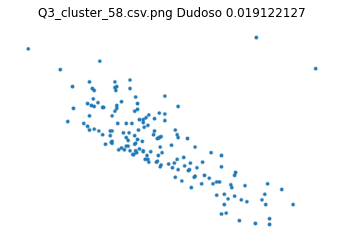

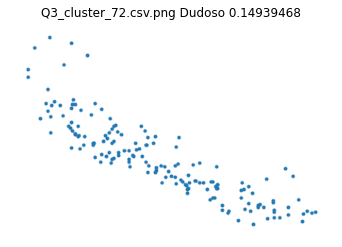

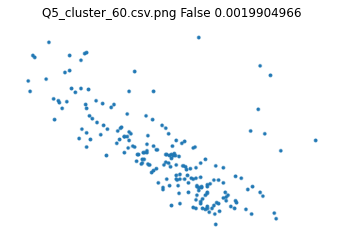

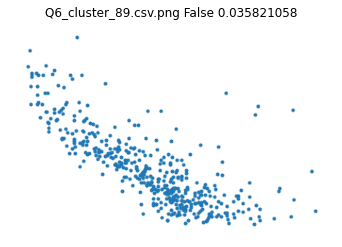

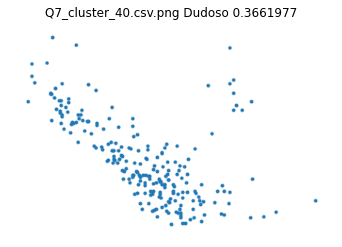

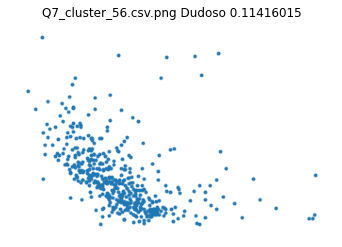

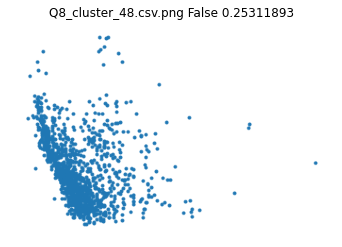

All images have been displayed.


In [13]:
image_names = verificacion_campo.keys()  # Replace with your list of image names
for image_name in image_names:
    # Full path to the image
    if verificacion_campo[image_name][0]=="False" or verificacion_campo[image_name][0]=="Dudoso":
        image_path = os.path.join(folder_path, image_name)
    
    # Load and display the image
        img = mpimg.imread(image_path)
        plt.imshow(img)
        plt.axis('off')  # Hide axis for better viewing
        plt.title(image_name+" " +str(verificacion_campo[image_name][0])+" "+str(verificacion_campo[image_name][1]))
        plt.show()

print("All images have been displayed.")


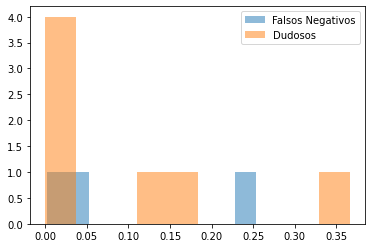

In [14]:
falsos_negativos_probabilidad=[]
falsos_dudosos_probabilidad=[]
image_names = verificacion_campo.keys()  # Replace with your list of image names
for image_name in image_names:
    # Full path to the image
    if verificacion_campo[image_name][0]=="False":
        falsos_negativos_probabilidad.append(verificacion_campo[image_name][1])
    if verificacion_campo[image_name][0]=="Dudoso":
        falsos_dudosos_probabilidad.append(verificacion_campo[image_name][1])
        

plt.hist(falsos_negativos_probabilidad,alpha=0.5,label="Falsos Negativos")
plt.hist(falsos_dudosos_probabilidad,alpha=0.5,label="Dudosos")
plt.legend()
plt.show()

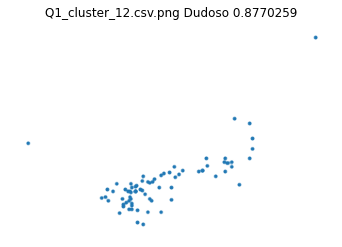

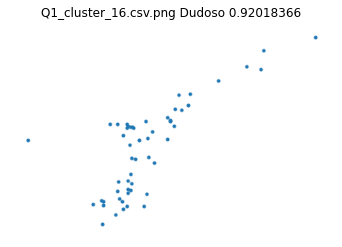

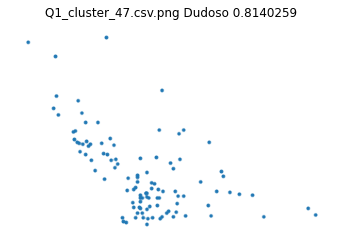

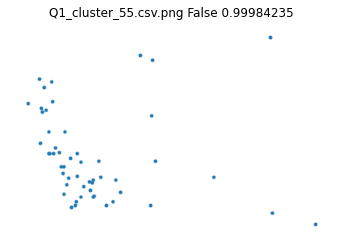

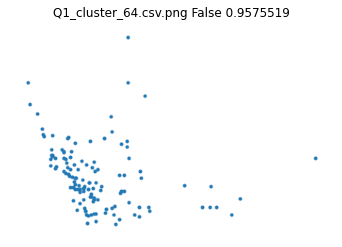

...

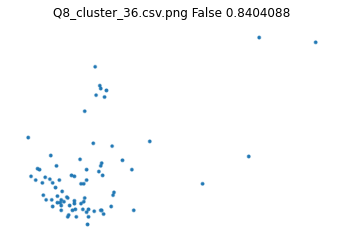

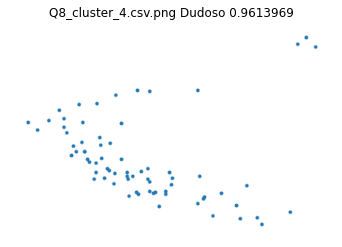

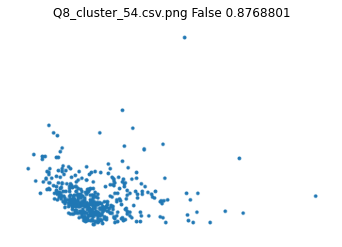

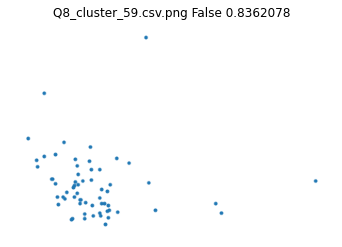

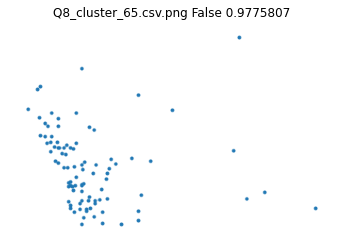

All images have been displayed.


In [15]:
image_names = verificacion_cumulo.keys()  # Replace with your list of image names
for image_name in image_names:
    # Full path to the image
    if verificacion_cumulo[image_name][0]=="False" or verificacion_cumulo[image_name][0]=="Dudoso":
        image_path = os.path.join(folder_path, image_name)
    
    # Load and display the image
        img = mpimg.imread(image_path)
        plt.imshow(img)
        plt.axis('off')  # Hide axis for better viewing
        plt.title(image_name+" " +str(verificacion_cumulo[image_name][0])+" "+str(verificacion_cumulo[image_name][1]))
        plt.show()

print("All images have been displayed.")

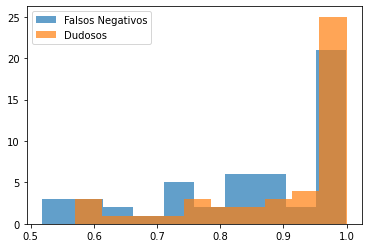

In [16]:
falsos_positivos_probabilidad=[]
positivos_dudosos_probabilidad=[]
image_names = verificacion_cumulo.keys()  # Replace with your list of image names
for image_name in image_names:
    # Full path to the image
    if verificacion_cumulo[image_name][0]=="False":
        falsos_positivos_probabilidad.append(verificacion_cumulo[image_name][1])
    if verificacion_cumulo[image_name][0]=="Dudoso":
        positivos_dudosos_probabilidad.append(verificacion_cumulo[image_name][1])
        

plt.hist(falsos_positivos_probabilidad,alpha=0.7,label="Falsos Negativos")
plt.hist(positivos_dudosos_probabilidad,alpha=0.7,label="Dudosos")
plt.legend()
plt.show()

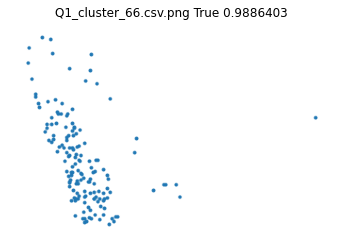

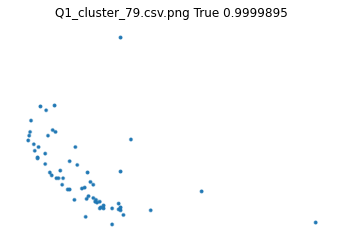

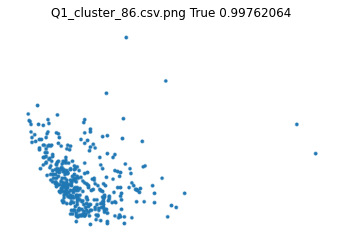

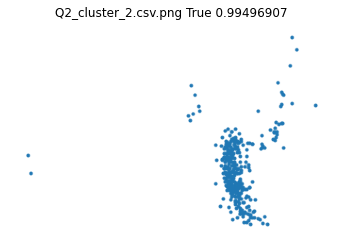

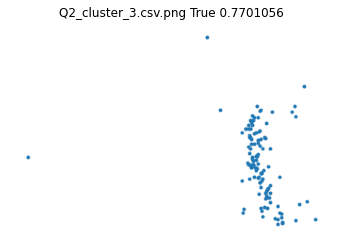

...

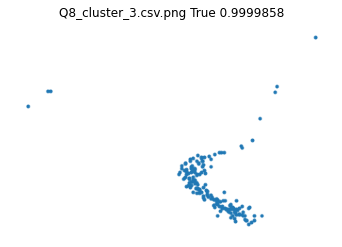

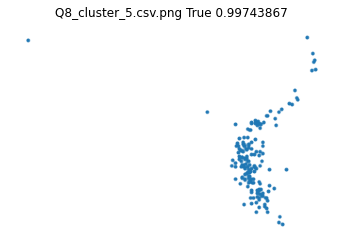

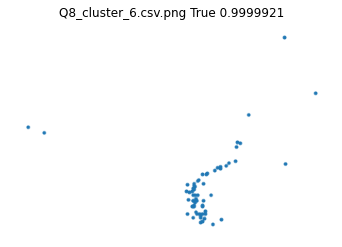

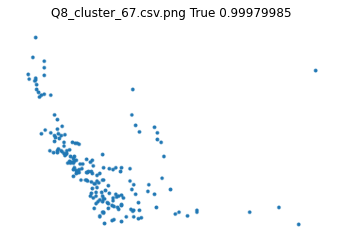

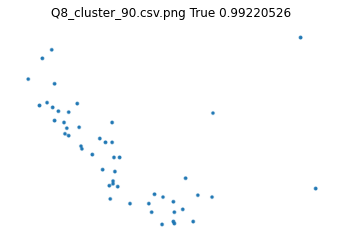

All images have been displayed.


In [17]:
image_names = verificacion_cumulo.keys()  # Replace with your list of image names
for image_name in image_names:
    # Full path to the image
    if verificacion_cumulo[image_name][0]=="True":
        image_path = os.path.join(folder_path, image_name)
    
    # Load and display the image
        img = mpimg.imread(image_path)
        plt.imshow(img)
        plt.axis('off')  # Hide axis for better viewing
        plt.title(image_name+" " +str(verificacion_cumulo[image_name][0])+" "+str(verificacion_cumulo[image_name][1]))
        plt.show()

print("All images have been displayed.")

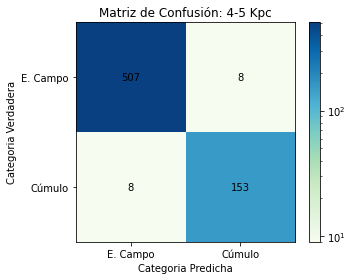

153 507 8 8
Precision: 0.9503105590062112
Recall: 0.9503105590062112
F1 Score: 0.9503105590062112


In [2]:
# Confusion matrix
array = np.array([[507, 8], [8, 153]])
# Define labels for rows and columns
labels = ["E. Campo", "Cúmulo"]

# Create the plot with a logarithmic color scale
plt.figure(figsize=(5, 4))  # Adjusted size to make the plot more compact
norm = mcolors.LogNorm(vmin=array.min() + 1, vmax=array.max())  # Log scale, vmin is adjusted to avoid log(0)
plt.imshow(array, interpolation="nearest", cmap="GnBu", norm=norm)
plt.colorbar()

# Add labels to x and y axes
plt.xticks([0, 1], labels)
plt.yticks([0, 1], labels)
plt.xlabel("Categoria Predicha")
plt.ylabel("Categoria Verdadera")
plt.title("Matriz de Confusión: 4-5 Kpc")

# Add text annotations
for i in range(array.shape[0]):
    for j in range(array.shape[1]):
        plt.text(j, i, f"{array[i, j]}", ha="center", va="center", color="black")

plt.tight_layout()  # Reduces the extra whitespace around the plot
plt.show()
# Extract the values
TN, FP = array[0, 0], array[0, 1]
FN, TP = array[1, 0], array[1, 1]

# Calculate precision, recall, and F1 score
precision = TP / (TP + FP)
recall = TP / (TP + FN)
print(TP, TN, FP, FN)
f1_score = 2 * (precision * recall) / (precision + recall)

print("Precision:", precision)
print("Recall:", recall)
print("F1 Score:", f1_score)

In [10]:
modelo_path=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\modelos\modelo1_prueba3_new_muestra.keras"
model.save(modelo_path,zipped=True)

### Shell 2

In [ ]:
# Data generators
train_datagen = ImageDataGenerator(
    rescale=1.0/255.0,
    rotation_range=10,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=False,
    vertical_flip=False,
#    validation_split=0.2  # 20% for validation
)

# CAMBIAR SHELL 1 O SHELL 2
train_data_dir = shell2

# Training data
train_generator = train_datagen.flow_from_directory(
    train_data_dir,
    target_size=(253, 385),
    batch_size=32,
    class_mode='binary',
    classes=['no-cumulos', 'cumulos'],
    shuffle=True,
    #subset='training'  # Training set (80%)
)

def get_model():
    base_model = InceptionV3(input_shape = (253,385,3), weights='imagenet', include_top=False)
    x = base_model.output
    x = keras.layers.GlobalAveragePooling2D()(x)
    x = keras.layers.Dense(1024, activation='relu')(x)
    x = keras.layers.BatchNormalization()(x)
    x = keras.layers.Dense(512, activation='relu')(x)
    x = keras.layers.BatchNormalization()(x)
    predictions = keras.layers.Dense(1, activation='sigmoid')(x)
    model = keras.models.Model(inputs=base_model.input, outputs=predictions)
    for layer in base_model.layers:
        layer.trainable = False #Originalmente False, True en prueba
        
    for layer in base_model.layers[-150:]:
        layer.trainable = True
    return model
model = get_model()

# Compile the model
METRICS = [
      keras.metrics.TruePositives(name='tp'),
      keras.metrics.FalsePositives(name='fp'),
      keras.metrics.TrueNegatives(name='tn'),
      keras.metrics.FalseNegatives(name='fn'), 
      keras.metrics.BinaryAccuracy(name='accuracy'),
      keras.metrics.Precision(name='precision'),
      keras.metrics.Recall(name='recall'),
      keras.metrics.AUC(name='auc'),
]
model.compile(
    optimizer=keras.optimizers.Adam(0.001),
    loss='binary_crossentropy',
    metrics=METRICS)

model.fit(
    train_generator,
    epochs=10)


Found 10272 images belonging to 2 classes.


c:\Users\juang\anaconda3\lib\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/10
321/321 ━━━━━━━━━━━━━━━━━━━━ 1023s 3s/step - accuracy: 0.8889 - auc: 0.9442 - fn: 320.7422 - fp: 167.5963 - loss: 0.3160 - precision: 0.9179 - recall: 0.8555 - tn: 2408.9348 - tp: 2270.6274
Epoch 2/10
321/321 ━━━━━━━━━━━━━━━━━━━━ 946s 3s/step - accuracy: 0.9238 - auc: 0.9733 - fn: 246.9689 - fp: 132.8261 - loss: 0.1984 - precision: 0.9432 - recall: 0.9021 - tn: 2449.8696 - tp: 2338.2361
Epoch 3/10
321/321 ━━━━━━━━━━━━━━━━━━━━ 903s 3s/step - accuracy: 0.9295 - auc: 0.9760 - fn: 235.7609 - fp: 118.2050 - loss: 0.1840 - precision: 0.9512 - recall: 0.9075 - tn: 2457.1055 - tp: 2356.8291
Epoch 4/10
321/321 ━━━━━━━━━━━━━━━━━━━━ 815s 3s/step - accuracy: 0.9345 - auc: 0.9809 - fn: 215.1056 - fp: 125.8230 - loss: 0.1646 - precision: 0.9495 - recall: 0.9189 - tn: 2452.7671 - tp: 2374.2051
Epoch 5/10
321/321 ━━━━━━━━━━━━━━━━━━━━ 797s 2s/step - accuracy: 0.9415 - auc: 0.9814 - fn: 207.0714 - fp: 105.5932 - loss: 0.1596 - precision: 0.9599 - recall: 0.9216 - tn: 2480.2297 - tp: 2375.0061

In [3]:
epochs = list(range(1, 11))  # Epochs 1 to 10

accuracy = [0.8889, 0.9238, 0.9295, 0.9345, 0.9415, 0.9422, 0.9463, 0.9432, 0.9495, 0.9457]
auc = [0.9442, 0.9733, 0.9760, 0.9809, 0.9814, 0.9824, 0.9863, 0.9862, 0.9885, 0.9850]
fn = [320.7422, 246.9689, 235.7609, 215.1056, 207.0714, 200.2640, 182.1956, 177.7702, 159.8106, 179.6615]
fp = [167.5963, 132.8261, 118.2050, 125.8230, 105.5932, 111.1646, 103.2236, 108.0124, 99.9876, 92.3540]
loss = [0.3160, 0.1984, 0.1840, 0.1646, 0.1596, 0.1566, 0.1380, 0.1436, 0.1303, 0.1456]
precision = [0.9179, 0.9432, 0.9512, 0.9495, 0.9599, 0.9553, 0.9593, 0.9529, 0.9596, 0.9639]
recall = [0.8555, 0.9021, 0.9075, 0.9189, 0.9216, 0.9269, 0.9315, 0.9306, 0.9383, 0.9263]
tn = [2408.9348, 2449.8696, 2457.1055, 2452.7671, 2480.2297, 2464.1274, 2486.3789, 2500.4722, 2478.4255, 2493.9285]
tp = [2270.6274, 2338.2361, 2356.8291, 2374.2051, 2375.0061, 2392.3447, 2396.1025, 2381.6460, 2429.6770, 2401.9565]


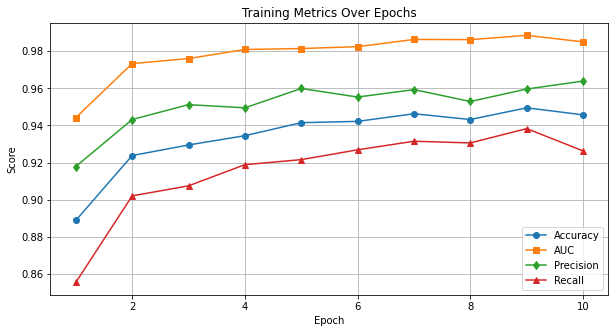

In [4]:
plt.figure(figsize=(10, 5))
plt.plot(epochs, accuracy, label="Accuracy", marker="o")
plt.plot(epochs, auc, label="AUC", marker="s")
plt.plot(epochs, precision, label="Precision", marker="d")
plt.plot(epochs, recall, label="Recall", marker="^")
plt.xlabel("Epoch")
plt.ylabel("Score")
plt.title("Training Metrics Over Epochs")
plt.legend()
plt.grid()
plt.show()

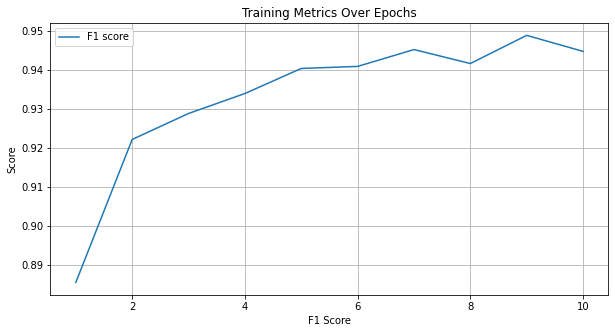

0.9488304757890301


In [6]:
plt.figure(figsize=(10, 5))
f1score=[]
for i in range(10):
    x=2*((precision[i]*recall[i])/(precision[i]+recall[i]))
    f1score.append(x)
plt.plot(epochs, f1score, label="F1 score")
plt.xlabel("F1 Score")
plt.ylabel("Score")
plt.title("Training Metrics Over Epochs")
plt.legend()
plt.grid()
plt.show()
print(f1score[-2])

In [8]:
modelo_path=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\modelos\modelo2.keras"
model.save(modelo_path,zipped=True)

### Cargar modelo

In [4]:
modelo_path_new=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\modelos\modelo3_30ciclos_shell2.keras"
new_model = tf.keras.models.load_model(modelo_path_new)


In [5]:
resultados={}
folder_path = r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\8 Semestre\Proyecto Teorico\Proyecto Teorico 20242\Gaia-DR3-Proyecto-Teorico-20242\data_v2_diagramas\shell2\prueba"
for file in os.listdir(folder_path):
    img_path=os.path.join(folder_path,file)
    img = image.load_img(img_path, target_size=(253, 385))
 # Preprocessing the image
    x = image.img_to_array(img)
# x = np.true_divide(x, 255)
## Scaling
    x=x/255
    x = np.expand_dims(x, axis=0)
    preds = new_model.predict(x)
#preds=np.argmax(preds, axis=1)

    print(file+"   :"+str(preds))
    resultados[file]=preds[0][0]

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
Q1_cluster_0.csv.png   :[[0.0030371]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step
Q1_cluster_1.csv.png   :[[0.9874504]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step
Q1_cluster_10.csv.png   :[[0.11536337]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step
Q1_cluster_100.csv.png   :[[0.00400263]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step
Q1_cluster_101.csv.png   :[[0.00344434]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step
Q1_cluster_102.csv.png   :[[0.17583776]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step
Q1_cluster_103.csv.png   :[[0.0279476]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step
Q1_cluster_104.csv.png   :[[0.08602616]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step
Q1_cluster_105.csv.png   :[[0.70293033]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step
Q1_cluster_106.csv.png   :[[0.00622593]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step
Q1_cluster_107.csv.png   :[[0.59154516]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step
Q1_cluster_108.csv.png   :[[0.00085723]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step
Q1_cluster_1

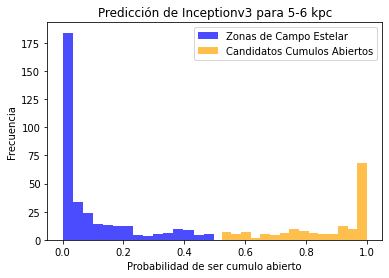

In [6]:
prediccion_shell2=list(resultados.values())
threshold = 0.5

# Split data into two groups
data_below_threshold = [x for x in prediccion_shell2 if x <= threshold]
data_above_threshold = [x for x in prediccion_shell2 if x > threshold]
# Plot histograms
plt.hist(data_below_threshold, bins=15, color='blue', alpha=0.7, label="Zonas de Campo Estelar")
plt.hist(data_above_threshold, bins=15, color='orange', alpha=0.7, label="Candidatos Cumulos Abiertos")

# Add labels and legend
plt.xlabel('Probabilidad de ser cumulo abierto')
plt.ylabel('Frecuencia')
plt.title('Predicción de Inceptionv3 para 5-6 kpc')
plt.legend()

# Show plot
plt.show()

In [7]:
cumulos_resultados={}
campo_resultados={}
llaves=resultados.keys()
for x in llaves:
    valor=resultados[x]
    if valor >0.5:
        cumulos_resultados[x]=valor
    else:
        campo_resultados[x]=valor

len(cumulos_resultados), len(campo_resultados)

(160, 339)

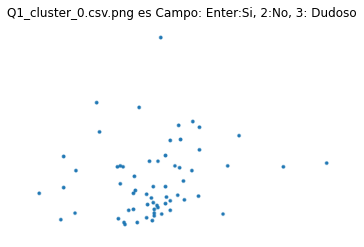

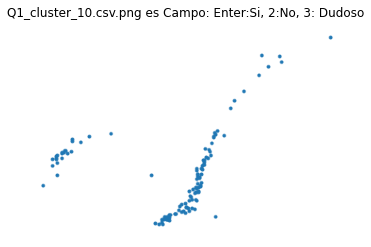

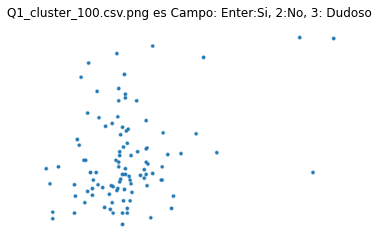

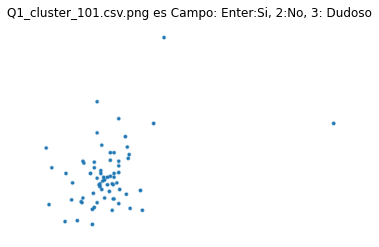

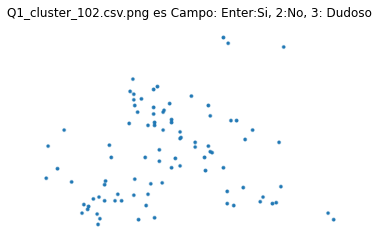

...

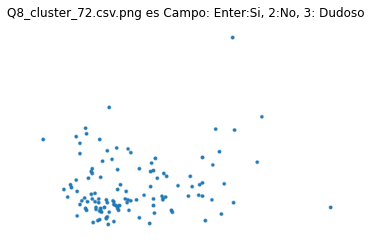

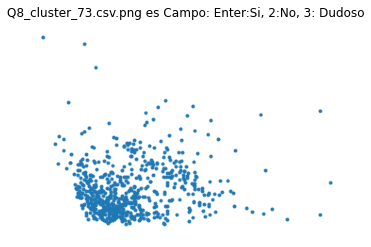

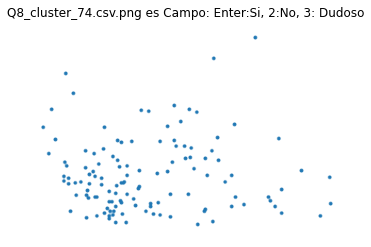

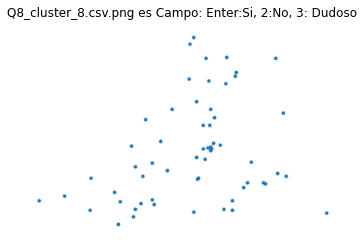

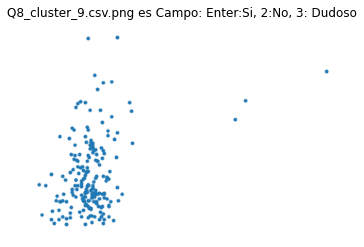

All images have been displayed.


In [8]:
# Folder path and list of image names
folder_path = clasificar_shell2  # Replace with your folder path
image_names = campo_resultados.keys()  # Replace with your list of image names
verificacion_campo={}
for image_name in image_names:
    # Full path to the image
    image_path = os.path.join(folder_path, image_name)
    
    # Load and display the image
    img = mpimg.imread(image_path)
    plt.imshow(img)
    plt.axis('off')  # Hide axis for better viewing
    plt.title(image_name+" es Campo: Enter:Si, 2:No, 3: Dudoso")
    plt.show()
    
    # Wait for user input
    while True:
        user_input = input(f"Enter True or False for {image_name}: ")
        if user_input in ["", "2","3"]:
            if user_input=="":
                user_input=["True",campo_resultados[image_name]]
            elif user_input=="2":
                user_input=["False",campo_resultados[image_name]]
            elif user_input=="3":
                user_input=["Dudoso",campo_resultados[image_name]]
            verificacion_campo[image_name]=us
            er_input
            break  # Proceed to the next image if input is valid
        else:
            print("Please enter either 'True' or 'False'.")

print("All images have been displayed.")


In [9]:
falsos_negativos=0
campos_dudosos=0
for x in verificacion_campo.keys():
    if verificacion_campo[x][0]=="False":
        falsos_negativos+=1
    if verificacion_campo[x][0]=="Dudoso":
        campos_dudosos+=1
    
print(falsos_negativos, campos_dudosos)

1 8


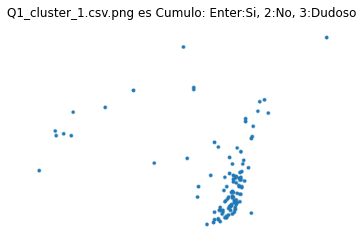

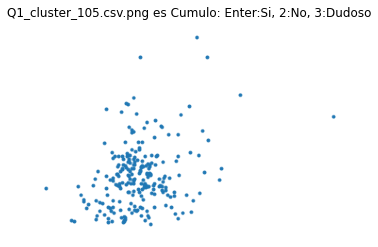

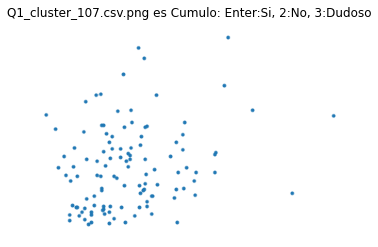

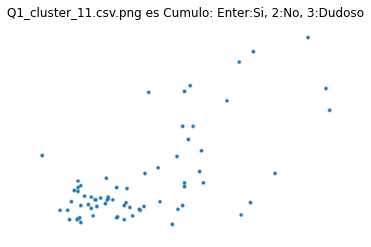

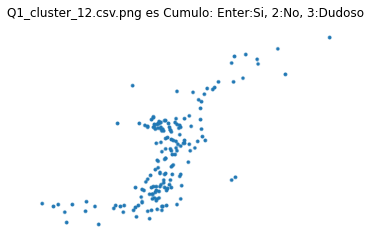

...

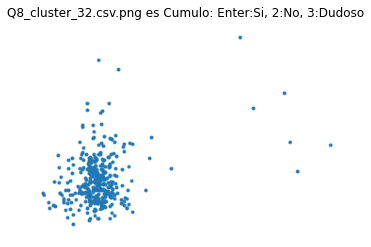

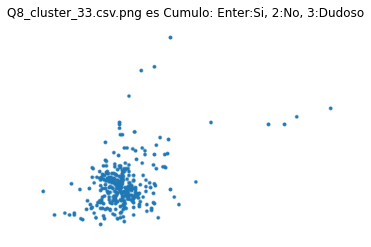

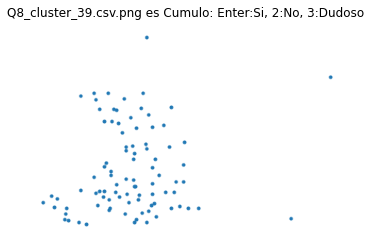

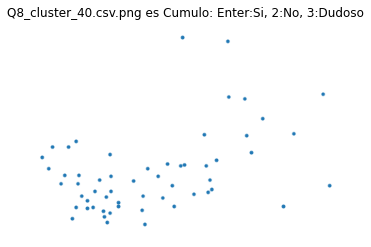

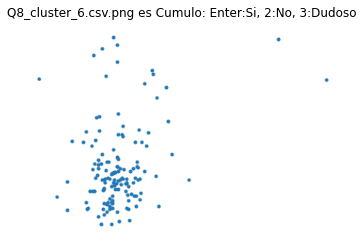

All images have been displayed.


In [10]:
# Folder path and list of image names
folder_path = clasificar_shell2  # Replace with your folder path
image_names = cumulos_resultados.keys()  # Replace with your list of image names
verificacion_cumulo={}
for image_name in image_names:
    # Full path to the image
    image_path = os.path.join(folder_path, image_name)
    
    # Load and display the image
    img = mpimg.imread(image_path)
    plt.imshow(img)
    plt.axis('off')  # Hide axis for better viewing
    plt.title(image_name+" es Cumulo: Enter:Si, 2:No, 3:Dudoso")
    plt.show()
    
    # Wait for user input
    while True:
        user_input = input(f"Enter True or False for {image_name}: ")
        if user_input in ["", "2","3"]:
            if user_input=="":
                user_input=["True",cumulos_resultados[image_name]]
            elif user_input=="2":
                user_input=["False",cumulos_resultados[image_name]]
            elif user_input=="3":
                user_input=["Dudoso",cumulos_resultados[image_name]]
            verificacion_cumulo[image_name]=user_input
            break  # Proceed to the next image if input is valid
        else:
            print("Please enter either 'True' or 'False'.")

print("All images have been displayed.")


In [11]:
falsos_positivos=0
cumulos_dudosos=0
for x in verificacion_cumulo.keys():
    if verificacion_cumulo[x][0]=="False":
        falsos_positivos+=1
    if verificacion_cumulo[x][0]=="Dudoso":
        cumulos_dudosos+=1

print(falsos_positivos, cumulos_dudosos)

80 21


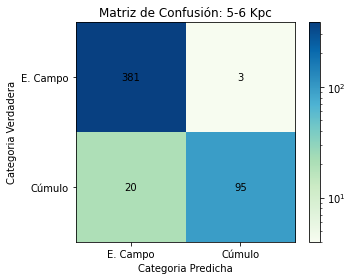

Precision: 0.9693877551020408
Recall: 0.8260869565217391
F1 Score: 0.8920187793427229


In [18]:
# Confusion matrix
array = np.array([[381, 3], [20, 95]])
# Define labels for rows and columns
labels = ["E. Campo", "Cúmulo"]

# Create the plot with a logarithmic color scale
plt.figure(figsize=(5, 4))  # Adjusted size to make the plot more compact
norm = mcolors.LogNorm(vmin=array.min() + 1, vmax=array.max())  # Log scale, vmin is adjusted to avoid log(0)
plt.imshow(array, interpolation="nearest", cmap="GnBu", norm=norm)
plt.colorbar()

# Add labels to x and y axes
plt.xticks([0, 1], labels)
plt.yticks([0, 1], labels)
plt.xlabel("Categoria Predicha")
plt.ylabel("Categoria Verdadera")
plt.title("Matriz de Confusión: 5-6 Kpc")

# Add text annotations
for i in range(array.shape[0]):
    for j in range(array.shape[1]):
        plt.text(j, i, f"{array[i, j]}", ha="center", va="center", color="black")

plt.tight_layout()  # Reduces the extra whitespace around the plot
plt.show()
# Extract the values
TN, FP = array[0, 0], array[0, 1]
FN, TP = array[1, 0], array[1, 1]

# Calculate precision, recall, and F1 score
precision = TP / (TP + FP)
recall = TP / (TP + FN)
f1_score = 2 * (precision * recall) / (precision + recall)

print("Precision:", precision)
print("Recall:", recall)
print("F1 Score:", f1_score)